# License

    Early Graft Loss and its impact, a kidney transplant analysis. - Part 2: Data Analyses.
    Copyright (C) 2020  J.R.M. Martens

    This program is free software: you can redistribute it and/or modify
    it under the terms of the GNU General Public License as published by
    the Free Software Foundation, either version 3 of the License, or
    (at your option) any later version.

    This program is distributed in the hope that it will be useful,
    but WITHOUT ANY WARRANTY; without even the implied warranty of
    MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
    GNU General Public License for more details.

    You should have received a copy of the GNU General Public License
    along with this program.  If not, see <https://www.gnu.org/licenses/>.

# Setup

###### Global Imports

In [1]:
import pandas as pd
import numpy as np
from scipy import stats
from lifelines import KaplanMeierFitter
import matplotlib.pyplot as plt
import seaborn as sns
# sns.set()
# sns.style('ticks')
%matplotlib inline

plt.rcParams['savefig.bbox'] = 'tight'
plt.rcParams['figure.dpi'] = 300

###### Global Functions

In [2]:
def print_columns(data):
    for i in sorted(list(data.columns)):
        print(i)
        
def grouping(data, columns, print_=False):
    table = data.groupby(columns[:-1])[columns[-1]].value_counts()
    if print_: print(table)
    return table

##### Resources
- Kaplan Meier Curve NFL (https://github.com/savvastj/nfl_survival_analysis/blob/master/Survival_Analysis_Kaplan_Meier.ipynb)

###### Global Parameters

In [3]:
export = True
egl = 'early_graftloss'

## Data Loading

In [4]:
%%time
# Set date values
# dates = ['d_admission_date', 'd_death_date', 'r_first_dialysis_date', 'nephrectomy_date', 'transplant_date', 'r_graft_fail_date', 'r_death_date', 'r_seen_last_date', 'r_seen_max_date']
dates = ['r_transplant_date']
# Load in data 
folder = '../data/'
file = 'data_20-04-11.csv'
filename = folder + file
df = pd.read_csv(filename, sep=';', decimal=',', na_values=' ', parse_dates=dates)

CPU times: user 55.7 ms, sys: 8.93 ms, total: 64.7 ms
Wall time: 64.2 ms


##### Data Drop

In [5]:
print("Before:\t", len(df), '\tColumns: ', len(df.columns))

df = df[(df['retransplant'] <= 2)]       # too few to analyse
removed = [                 # percentage of missing values
    'd_diabetes_since',     # 98
    'd_hypertension_since', # 92
    'd_smoking_pack_years', # 81
]
df = df.drop(columns=removed)

print("After:\t", len(df), '\tColumns: ', len(df.columns))

Before:	 10360 	Columns:  67
After:	 10261 	Columns:  64


In [6]:
# Remove singe infinity value from d_MDRD when d_age is 0
df.loc[2524] = df.loc[2524].replace(np.inf, np.nan)

# Exploratory Data Analysis
## Data Profiling

In [7]:
import pandas_profiling as pp    # create pandas profiling report
import os.path                   # to check whether file exists
import webbrowser                # open pp reports

def profile(data, file='temp'):
    # Drop id column (unique)
    data = data.drop(columns=['id'])
    
    # Define output filename
    folder = 'profiles/'
    extension = '.html'
    filename = folder + file + extension
    while os.path.isfile(filename):
        file += '#'
        filename = folder + file + extension
        
    # Create report and open in browser
    profile = pp.ProfileReport(data)
    # rejected_variables = profile.get_rejected_variables(threshold=0.9)
    profile.to_file(outputfile=filename)
    webbrowser.open('file://' + os.path.realpath(filename))
    
# profile(df, file='report_20-04-12')

In [8]:
# columns = ['retransplant','r_sex', 'early_graftloss']
# grouping(df, columns)

# Analysis Preparation

## Helper functions

In [9]:
def get_row(ID):
    return df[df['id'] == ID].iloc[0]

### Transplant functions

In [10]:
nr_transplants = df.groupby('r_id')['id'].nunique()

def get_first_transplant(ID):
    row = get_row(ID)
    retransplant = row['retransplant']
    if retransplant == 0 or retransplant == 1:
        return ID
    else:
        while retransplant > 1:
            ID = get_previous_transplant(ID)
            retransplant = retransplant - 1
        return ID

def get_nr_transplants(ID):
    r_id = df[df['id'] == ID]['r_id'].iloc[0]
    nr_transplants = df.groupby('r_id')['id'].nunique()
    return nr_transplants[r_id]

def get_previous_transplant(ID):
    row = get_row(ID)
    retransplant = row['retransplant']
    if retransplant == 0 or retransplant == 1:
        return None
    else:
        previous = df[((df['r_id'] == row['r_id']) & (df['retransplant'] == (retransplant-1)))]['id'].iloc[0]
        return previous
    
def get_next_transplant(ID):
    row = get_row(ID)
    retransplant = row['retransplant']
    if retransplant == 0:
        return None
    elif get_nr_transplants(ID) <= retransplant:
        return None
    else:
        nxt = df[((df['r_id'] == row['r_id']) & (df['retransplant'] == (retransplant+1)))]['id'].iloc[0]
        return nxt

def get_days_previous_transplant(ID):
    row = get_row(ID)
    retransplant = row['retransplant']
    if retransplant == 0 or retransplant == 1:
        return np.nan
    else:
        prev = get_previous_transplant(ID)
        prev_row = get_row(prev)
        return prev_row['retransplant_days']

## Helper Columns

### Differences

In [11]:
def difference_age(x):
    if pd.notnull(x['r_age']):
        if pd.notnull(x['d_age']):
            return x['r_age'] - x['d_age']
    else:
        return np.nan
    
df['difference_age'] = df.apply(difference_age, axis=1)

In [12]:
def difference_BMI(x):
    if pd.notnull(x['r_BMI']):
        if pd.notnull(x['d_BMI']):
            return x['r_BMI'] - x['d_BMI']
    else:
        return np.nan
    
df['difference_BMI'] = df.apply(difference_BMI, axis=1)

In [13]:
def difference_sex(x):
    if x['d_sex'] == x['r_sex']:
        return 1
    else:
        return 0
    
df['difference_sex'] = df.apply(difference_sex, axis=1)
df['difference_sex'].value_counts(dropna=False)

1    5338
0    4923
Name: difference_sex, dtype: int64

### Numerical -> Categories

Underweight = <18.5  
Normal weight = 18.5–24.9  
Overweight = 25–29.9  
Obesity = BMI of 30 or greater  
Source: https://www.nhlbi.nih.gov/health/educational/lose_wt/BMI/bmicalc.htm

In [14]:
def d_BMI_cat(x):
    BMI = x['d_BMI']
    if pd.isnull(BMI):
        return np.nan
    elif BMI < 18.5:
        return 0 # Underweight
    elif BMI < 25:
        return 1 # Normal
    elif BMI < 30:
        return 2 # Overweight
    else:
        return 3 # Obesity  
    
df['d_BMI_cat'] = df.apply(d_BMI_cat, axis=1)
df['d_BMI_cat'].value_counts(dropna=False)

1.0    5326
2.0    3023
3.0     834
NaN     695
0.0     383
Name: d_BMI_cat, dtype: int64

In [15]:
def r_BMI_cat(x):
    BMI = x['r_BMI']
    if pd.isnull(BMI):
        return np.nan
    elif BMI < 18.5:
        return 0 # Underweight
    elif BMI < 25:
        return 1 # Normal
    elif BMI < 30:
        return 2 # Overweight
    else:
        return 3 # Obesity    
    
df['r_BMI_cat'] = df.apply(r_BMI_cat, axis=1)
df['r_BMI_cat'].value_counts(dropna=False)

1.0    3849
2.0    2645
NaN    2353
3.0    1094
0.0     320
Name: r_BMI_cat, dtype: int64

In [16]:
def d_age_cat(x):
    age = x['d_age']
    if pd.isnull(age):
        return np.nan
    elif age < 12:
        return 0 # Kid
    elif age < 18:
        return 1 # Teen
    elif age < 35:
        return 2 # Adolescant
    elif age < 55:
        return 3 # Adult
    elif age < 65:
        return 4 # Old
    else:
        return 5 # Elderly    
    
df['d_age_cat'] = df.apply(d_age_cat, axis=1)
df['d_age_cat'].value_counts(dropna=False)

3.0    4187
4.0    2455
2.0    1748
5.0    1227
1.0     426
0.0     217
NaN       1
Name: d_age_cat, dtype: int64

In [17]:
def r_age_cat(x):
    age = x['r_age']
    if pd.isnull(age):
        return np.nan
    elif age < 12:
        return 0 # Kid
    elif age < 18:
        return 1 # Teen
    elif age < 35:
        return 2 # Adolescant
    elif age < 55:
        return 3 # Adult
    elif age < 65:
        return 4 # Old
    else:
        return 5 # Elderly    
    
df['r_age_cat'] = df.apply(r_age_cat, axis=1)
df['r_age_cat'].value_counts(dropna=False)

3    4167
4    2673
5    1837
2    1368
1     216
Name: r_age_cat, dtype: int64

In [18]:
def r_PRA_cat(x):
    PRA = x['r_PRA']
    if pd.isnull(PRA):
        return np.nan
    elif PRA == 0:
        return 0 # 0
    elif PRA < 5:
        return 1 # 0-5
    elif PRA < 50:
        return 2 # 5-50
    elif PRA < 95:
        return 3 # 50-95
    else:
        return 4 # 95-100    
    
df['r_PRA_cat'] = df.apply(r_PRA_cat, axis=1)
df['r_PRA_cat'].value_counts(dropna=False)

0.0    7552
2.0    1235
1.0     939
3.0     482
4.0      50
NaN       3
Name: r_PRA_cat, dtype: int64

### Early graft loss

In [19]:
def egl_after(x):
    next_ = get_next_transplant(x['id'])
    if next_ != None:
        next_row = get_row(next_)
        return next_row['early_graftloss']
    else:
        return 0

df['egl_after'] = df.apply(egl_after, axis=1)
df['egl_after'].value_counts(dropna=False)

0    10154
1      107
Name: egl_after, dtype: int64

In [20]:
def egl_before(x):
    prev = get_previous_transplant(x['id'])
    if prev != None:
        prev_row = get_row(prev)
        return prev_row['early_graftloss']
    else:
        return 0

df['egl_before'] = df.apply(egl_before, axis=1)
df['egl_before'].value_counts(dropna=False)

0    9920
1     341
Name: egl_before, dtype: int64

In [21]:
def egl_first(x):
    first = get_first_transplant(x['id'])
    first_row = get_row(first)
    return first_row['early_graftloss']

df['egl_first'] = df.apply(egl_first, axis=1)
df['egl_first'].value_counts(dropna=False)

0    9111
1    1150
Name: egl_first, dtype: int64

In [22]:
# def pnf_before(x):
#     prev = get_previous_transplant(x['id'])
#     if prev != None:
#         prev_row = get_row(prev)
#         prev_pnf = prev_row['r_graft_fail_cause_cat']
#         if prev_pnf == 5 or prev_pnf == 6:
#             return 1
#         else:
#             return 0
#     else:
#         return 0

# df['pnf_before'] = df.apply(pnf_before, axis=1)

In [23]:
# Early Graft Loss in 30 days - 1 if graftloss and graft fail date <= 30 days
def early_graftloss_d30(x):
    if x['graftloss'] == 1:
        if x['r_graft_fail_date_diff'] <= 30:
            return 1
        else:
            return 0
    else:
        return 0
    
df['early_graftloss_d30'] = df.apply(early_graftloss_d30, axis=1)
df.groupby('early_graftloss_d30')['id'].nunique()

early_graftloss_d30
0    9576
1     685
Name: id, dtype: int64

In [24]:
def egl_before_d30(x):
    prev = get_previous_transplant(x['id'])
    if prev != None:
        prev_row = get_row(prev)
        return prev_row['early_graftloss_d30']
    else:
        return 0

df['egl_before_d30'] = df.apply(egl_before_d30, axis=1)
df['egl_before_d30'].value_counts(dropna=False)

0    9988
1     273
Name: egl_before_d30, dtype: int64

### Kaplan Meier

Durations until event or last seen date, needed for Kaplan Meier.

In [25]:
# duration from transplant to death date, otherwise last seen date
def duration(x):
    if pd.notnull(x['r_death_date_diff']):
        return x['r_death_date_diff']
    else:
        return x['r_seen_date_diff']

df['duration'] = df.apply(duration, axis=1)

In [26]:
# duration from transplant to graft fail date, otherwise death date, otherwise last seen
def km_graft(x):
    if pd.notnull(x['r_graft_fail_date_diff']):
        return x['r_graft_fail_date_diff']
    elif pd.notnull(x['r_death_date_diff']):
        return x['r_death_date_diff'] # Return r_death_date if there is no graft fail date
    else:
        return x['r_seen_date_diff']
    
df['km_graft'] = df.apply(km_graft, axis=1)

In [27]:
# duration from transplant until next transplant
def duration_retransplant(x):
    if pd.notnull(x['retransplant_days']):
        return x['retransplant_days']
    else:
        return x['r_seen_date_diff']

df['duration_rt'] = df.apply(duration_retransplant, axis=1)

In [28]:
# duration from graft fail date until retransplant
def retransplant_wait(x):
    if pd.notnull(x['retransplant_days']) and pd.notnull(x['r_graft_fail_date_diff']):
        diff = x['retransplant_days'] - x['r_graft_fail_date_diff']
        if diff >= 0:
            return diff
        else:
            return np.nan
    else:
        return np.nan

df['retransplant_wait'] = df.apply(retransplant_wait, axis=1)

In [29]:
# duration from graft fail date until retransplant, otherwise last seen date
def km_retransplant_wait(x):
    if pd.notnull(x['retransplant_wait']):
        return x['retransplant_wait']
    else:
        return x['r_seen_date_diff']
    
df['km_retransplant_wait'] = df.apply(km_retransplant_wait, axis=1)
# df[['km_graft', 'r_graft_fail_date_diff', 'r_death_date_diff']]

In [30]:
# duration from graft fail date until death date
def fail_death_diff(x):
    if pd.notnull(x['r_death_date_diff']) and pd.notnull(x['r_graft_fail_date_diff']):
        diff = x['r_death_date_diff'] - x['r_graft_fail_date_diff']
        if diff >= 0:
            return diff
        else:
            return np.nan
    else:
        return np.nan

df['fail_death_diff'] = df.apply(fail_death_diff, axis=1)

In [31]:
# duration from graft fail date until death date, otherwise last seen date
def km_fail_death_diff(x):
    if pd.notnull(x['fail_death_diff']):
        return x['fail_death_diff']
    else:
        return x['r_seen_date_diff']
    
df['km_fail_death_diff'] = df.apply(km_fail_death_diff, axis=1)
# df[['km_graft', 'r_graft_fail_date_diff', 'r_death_date_diff']]

In [32]:
# 30 day mortality
def mort(x):
    val = x['r_death_date_diff']
    if pd.notnull(val):
        if val >= 0 and val <= 30:
            return 1
    return 0
    
df['mort'] = df.apply(mort, axis=1)
df['mort_d30'] = df['mort']

In [33]:
# 1 year mortality
def mort_y1(x):
    val = x['r_death_date_diff']
    if pd.notnull(val):
        if val >= 0 and val <= 365:
            return 1
    return 0
    
df['mort_y1'] = df.apply(mort_y1, axis=1)

In [34]:
# 5 year mortality
def mort_y5(x):
    val = x['r_death_date_diff']
    if pd.notnull(val):
        if val >= 0 and val <= 365*5:
            return 1
    return 0
    
df['mort_y5'] = df.apply(mort_y5, axis=1)

In [35]:
# 10 year mortality
def mort_y10(x):
    val = x['r_death_date_diff']
    if pd.notnull(val):
        if val >= 0 and val <= 365*10:
            return 1
    return 0
    
df['mort_y10'] = df.apply(mort_y10, axis=1)

## Column Types

In [36]:
column_types = {
    'id': ['r_id', 'd_id'],
    'age': ['r_age', 'd_age'],
    'BMI': ['r_BMI', 'd_BMI'], 
    'MDRD': ['d_MDRD', 'r_MDRD_M3', 'r_MDRD_Y1', 'r_MDRD_Y5'],
    'height': ['r_height', 'd_height'],
    'weight': ['r_weight', 'd_weight'],
    'creatinine': ['r_creatinine_M3', 'r_creatinine_Y1', 'r_creatinine_Y5'],
    'proteinuria': ['r_proteinuria_M3', 'r_proteinuria_Y1', 'r_proteinuria_Y5'],
    'ischaemic': ['ischaemic_period_cold', 'ischaemic_period_warm_1', 'ischaemic_period_warm_2'],
    'mismatch': ['mismatch_A', 'mismatch_B', 'mismatch_DR'],
    'binary': ['d_sex', 'd_cardiac_arrest', 'd_cadaveric_type', 'd_diabetes', 'd_hypertension', 'd_hypotensive_periods', 'd_smoking', 'early_graftloss', 'graftloss', 'r_sex', 'r_dead'],
    'pseudo_binary': ['d_NHB_cat'],
    'categoric': ['d_death_cause_cat', 'preservation_solution_type_cat', 'r_death_cause_cat', 'r_graft_fail_cause_cat', 'r_last_dialysis_technique_cat', 'r_disease_recurrent', 'retransplant'],
    'date': ['r_transplant_date'],
    'date_diff': ['d_death_date_diff', 'd_nephrectomy_date_diff', 'r_death_date_diff', 'r_first_dialysis_date_diff', 'r_graft_fail_date_diff', 'r_seen_date_diff', 'retransplant_days'],
    'other': ['d_diabetes_since', 'd_hypertension_since', 'd_hypotensive_periods_duration', 'd_smoking_pack_years', 'preservation_solution_volume'],
    'ignored': ['d_creatinine_highest', 'd_creatinine_last'],
    'differences': ['difference_age', 'difference_BMI'],
    'conversions': ['d_BMI_cat', 'r_BMI_cat', 'd_age_cat', 'r_age_cat', 'r_PRA_cat']
}
numerical_types = ['age', 'BMI', 'MDRD', 'height', 'weight', 'ischaemic'] # , 'creatine', 'proteinuria'
binary_types = ['binary', 'pseudo_binary']
categoric_types = ['categoric', 'mismatch']
date_diff_types = ['date_diff']
differences_types = ['differences']
conversions_types = ['conversions']

In [37]:
mean_columns = []
for ctype in numerical_types:
    mean_columns += column_types[ctype]
binary_columns = column_types['binary'] + column_types['pseudo_binary']
categoric_columns = column_types['categoric'] + column_types['mismatch'] # + column_types['conversions']
date_diff_columns = column_types['date_diff']

## Subsets
Subsets to use for selecting subgroups of the dataset.

Note: 
- all start with ix
- only use when no missing values (or when missing values mean the same as the group excluded)

In [38]:
ix_all = (df['id'] >= -1)

In [39]:
# Transplants
ix_tx0 = (df['retransplant'] == 0)
ix_tx1 = (df['retransplant'] == 1)
ix_tx01 = ((df['retransplant'] == 0) | (df['retransplant'] == 1))
ix_tx2 = (df['retransplant'] == 2)
ix_tx3 = (df['retransplant'] == 3)
ix_tx4 = (df['retransplant'] == 4)
ix_tx5 = (df['retransplant'] == 5)

ix_tx_after = (df['retransplant_after'] == 1)
ix_retransplant_after = ix_tx_after

In [40]:
# Graftloss related
ix_egl = (df['early_graftloss'] == 1)
ix_egl_d30 = (df['early_graftloss_d30'] == 1)
ix_egl_d90 = ix_egl
ix_gl = (df['graftloss'] == 1)

ix_egl_before = (df['egl_before'] == 1)
ix_egl_before_d30 = (df['egl_before_d30'] == 1)
ix_egl_first = (df['egl_first'] == 1)
ix_egl_after = (df['egl_after'] == 1)

# ix_pnf = ((df['r_graft_fail_cause_cat'] == 5) | (df['r_graft_fail_cause_cat'] == 6))
# ix_pnf_before = (df['pnf_before'] == 1)

In [41]:
# Death related
ix_dead = (df['r_dead'] == 1)
ix_mort = (df['mort'] == 1)
ix_mort_d30 = (df['mort_d30'] == 1)
ix_mort_y1 = (df['mort_y1'] == 1)
ix_mort_y5 = (df['mort_y5'] == 1)
ix_mort_y10 = (df['mort_y10'] == 1)

ix_dcd = (df['d_cadaveric_type'] == 0)
ix_dbd = (df['d_cadaveric_type'] == 1)

In [42]:
# Binary
ix_d_male = (df['d_sex'] == 1)
ix_r_male = (df['r_sex'] == 1)
ix_same_sex = (df['difference_sex'] == 1)

# ix_cardiac_arrest = (df['d_cardiac_arrest'] == 1) # Care: missing values
# ix_diabetes = (df['d_diabetes'] >= 1) # Care: missing values
# ix_hypertension = (df['d_hypertension'] == 1) # Care: missing values
# ix_smoking = (df['d_smoking'] == 1) # Care: missing values
# ix_NHB_cat bad

### Year Subsets

- Single year
- Before year
- After year

By using before & after a period between can be selected.

In [43]:
years = list(range(1990, 2018))

In [44]:
# Create selectable for each year
ix_year = dict()
for year in years:
    start = str(year) + '-01-01'
    end = str(year) + '-12-31'
    ix_year[year] = ((df['r_transplant_date'] >= start) & (df['r_transplant_date'] <= end))

In [45]:
# Create selectable before for each year
ix_year_before = dict()
for year in years:
    end = str(year-1) + '-12-31'
    ix_year_before[year] = (df['r_transplant_date'] <= end)

In [46]:
# Create selectable after for each year
ix_year_after = dict()
for year in years:
    start = str(year+1) + '-01-01'
    ix_year_after[year] = (df['r_transplant_date'] >= start)

In [47]:
# Create subset for each paper
# Hamet et al. 2002 - 2012
ix_hamed = ix_year_after[2002] & ix_year_before[2013]
# Kuzminskis et al. 2000 - 2016
ix_kuzminskis = ix_year_after[2000] & ix_year_before[2017]
# Brooks et al. UNOS - 2011 - 2015
ix_brooks_unos = ix_year_after[2011] & ix_year_before[2016]
# Brooks et al. Single Center (sc) - 2004 - 2015
ix_brooks_sc = ix_year_after[2004] & ix_year_before[2016]

# Analysis

## General

In [48]:
def calc_percentage(tx, ix, correction=None, output=True):
    if isinstance(correction, pd.Series):
        print("CORRECTION:")
        calc_percentage(tx & correction, ix)
        print()
        print("Uncorrected:")
    number = len(df[tx & ix])
    total = len(df[tx])
    percentage = round(100*number/total,2)
    if output:
        print("Total length:\t", total)
        print("Number:\t\t", number)
        print("Percentage:\t", percentage, "%")
        return
    else:
        return number, total, percentage

### Early Graft Loss (EGL)

#### EGL - 90 days

In [49]:
# EGL at first transplant
calc_percentage(ix_tx01, ix_egl)

Total length:	 9446
Number:		 809
Percentage:	 8.56 %


In [50]:
# EGL at first transplant, dcd vs dbd
calc_percentage(ix_tx01, ix_egl, correction=ix_dcd)
print()
calc_percentage(ix_tx01, ix_egl, correction=ix_dbd)
print()
print("DCD vs DBD after 2009")
print()
calc_percentage(ix_tx01 & ix_dcd, ix_egl, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx01 & ix_dbd, ix_egl, correction=ix_year_after[2008])

CORRECTION:
Total length:	 2807
Number:		 240
Percentage:	 8.55 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %

CORRECTION:
Total length:	 6639
Number:		 569
Percentage:	 8.57 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %

DCD vs DBD after 2009

CORRECTION:
Total length:	 1601
Number:		 91
Percentage:	 5.68 %

Uncorrected:
Total length:	 2807
Number:		 240
Percentage:	 8.55 %

CORRECTION:
Total length:	 1538
Number:		 83
Percentage:	 5.4 %

Uncorrected:
Total length:	 6639
Number:		 569
Percentage:	 8.57 %


In [51]:
# EGL at first transplant
calc_percentage(ix_tx01, ix_egl, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx01, ix_egl, correction=ix_year_before[2009])

CORRECTION:
Total length:	 3139
Number:		 174
Percentage:	 5.54 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %

CORRECTION:
Total length:	 6307
Number:		 635
Percentage:	 10.07 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %


In [52]:
# Percentage of EGL in second transplant
calc_percentage(ix_tx2, ix_egl, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2, ix_egl, correction=ix_year_before[2009])
print("\nEGL BEFORE:\n")
calc_percentage(ix_tx2 & ix_egl_before, ix_egl, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2 & ix_egl_before, ix_egl, correction=ix_year_before[2009])
print("\nNOT EGL BEFORE:\n")
calc_percentage(ix_tx2 & ~ix_egl_before, ix_egl, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2 & ~ix_egl_before, ix_egl, correction=ix_year_before[2009])

CORRECTION:
Total length:	 303
Number:		 16
Percentage:	 5.28 %

Uncorrected:
Total length:	 815
Number:		 107
Percentage:	 13.13 %

CORRECTION:
Total length:	 512
Number:		 91
Percentage:	 17.77 %

Uncorrected:
Total length:	 815
Number:		 107
Percentage:	 13.13 %

EGL BEFORE:

CORRECTION:
Total length:	 87
Number:		 10
Percentage:	 11.49 %

Uncorrected:
Total length:	 341
Number:		 59
Percentage:	 17.3 %

CORRECTION:
Total length:	 254
Number:		 49
Percentage:	 19.29 %

Uncorrected:
Total length:	 341
Number:		 59
Percentage:	 17.3 %

NOT EGL BEFORE:

CORRECTION:
Total length:	 216
Number:		 6
Percentage:	 2.78 %

Uncorrected:
Total length:	 474
Number:		 48
Percentage:	 10.13 %

CORRECTION:
Total length:	 258
Number:		 42
Percentage:	 16.28 %

Uncorrected:
Total length:	 474
Number:		 48
Percentage:	 10.13 %


In [53]:
# Compare Papers
# Kizminskis et al. 2000-2016
calc_percentage(ix_tx01, ix_egl, correction=ix_year_after[2000] & ix_year_before[2017])
print()
# Brooks et al. UNOS Database - 2011-2015
calc_percentage(ix_tx01, ix_egl, correction=ix_year_after[2011] & ix_year_before[2016])
print()
# Brooks et al. Single Center Database - 2004-2015
calc_percentage(ix_tx01, ix_egl, correction=ix_year_after[2004] & ix_year_before[2016])

CORRECTION:
Total length:	 5423
Number:		 387
Percentage:	 7.14 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %

CORRECTION:
Total length:	 1559
Number:		 95
Percentage:	 6.09 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %

CORRECTION:
Total length:	 3869
Number:		 257
Percentage:	 6.64 %

Uncorrected:
Total length:	 9446
Number:		 809
Percentage:	 8.56 %


In [54]:
# Percentage of EGL in first transplant and receive a second transplant
calc_percentage(ix_tx01 & ix_egl, ix_retransplant_after, correction=ix_year_before[2013])
print()
calc_percentage(ix_tx01 & ix_egl & ~ix_mort, ix_retransplant_after, correction=ix_year_before[2013])
# calc_percentage(ix_tx2, ix_egl_first) # INCORRECT! 815 seems close to 809 but is number of second transplants

CORRECTION:
Total length:	 711
Number:		 322
Percentage:	 45.29 %

Uncorrected:
Total length:	 809
Number:		 341
Percentage:	 42.15 %

CORRECTION:
Total length:	 676
Number:		 322
Percentage:	 47.63 %

Uncorrected:
Total length:	 767
Number:		 341
Percentage:	 44.46 %


In [55]:
# Percentage of EGL in first and second transplant 
calc_percentage(ix_tx2 & ix_egl_before, ix_egl)

Total length:	 341
Number:		 59
Percentage:	 17.3 %


#### EGL - 30 days

In [56]:
# Compare Papers
# Hamed et al. 2002-2012
calc_percentage(ix_tx01 & ix_hamed, ix_egl_d30)

Total length:	 3368
Number:		 179
Percentage:	 5.31 %


In [57]:
# EGL at first transplant, pre 2009 vs post 2009
calc_percentage(ix_tx01, ix_egl_d30, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx01, ix_egl_d30, correction=ix_year_before[2009])

CORRECTION:
Total length:	 3139
Number:		 127
Percentage:	 4.05 %

Uncorrected:
Total length:	 9446
Number:		 600
Percentage:	 6.35 %

CORRECTION:
Total length:	 6307
Number:		 473
Percentage:	 7.5 %

Uncorrected:
Total length:	 9446
Number:		 600
Percentage:	 6.35 %


In [58]:
# EGL at first transplant, DCD vs DBD
calc_percentage(ix_tx01, ix_egl_d30, correction=ix_dbd)
print()
calc_percentage(ix_tx01, ix_egl_d30, correction=ix_dcd)

CORRECTION:
Total length:	 6639
Number:		 416
Percentage:	 6.27 %

Uncorrected:
Total length:	 9446
Number:		 600
Percentage:	 6.35 %

CORRECTION:
Total length:	 2807
Number:		 184
Percentage:	 6.56 %

Uncorrected:
Total length:	 9446
Number:		 600
Percentage:	 6.35 %


In [59]:
# EGL at first transplant, Hamed et al. DCD vs DBD
calc_percentage(ix_tx01 & ix_hamed, ix_egl_d30, correction=ix_dbd)
print()
calc_percentage(ix_tx01 & ix_hamed, ix_egl_d30, correction=ix_dcd)

CORRECTION:
Total length:	 1884
Number:		 87
Percentage:	 4.62 %

Uncorrected:
Total length:	 3368
Number:		 179
Percentage:	 5.31 %

CORRECTION:
Total length:	 1484
Number:		 92
Percentage:	 6.2 %

Uncorrected:
Total length:	 3368
Number:		 179
Percentage:	 5.31 %


In [60]:
# EGL at first transplant, Hamed et al. DCD vs DBD
calc_percentage(ix_tx01 & ix_hamed & ix_dbd, ix_egl_d30, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx01 & ix_hamed & ix_dcd, ix_egl_d30, correction=ix_year_after[2008])

CORRECTION:
Total length:	 756
Number:		 28
Percentage:	 3.7 %

Uncorrected:
Total length:	 1884
Number:		 87
Percentage:	 4.62 %

CORRECTION:
Total length:	 639
Number:		 23
Percentage:	 3.6 %

Uncorrected:
Total length:	 1484
Number:		 92
Percentage:	 6.2 %


In [61]:
# Percentage of EGL in second transplant
calc_percentage(ix_tx2, ix_egl_d30, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2, ix_egl_d30, correction=ix_year_before[2009])
print("\nEGL BEFORE:\n")
calc_percentage(ix_tx2 & ix_egl_before_d30, ix_egl_d30, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2 & ix_egl_before_d30, ix_egl_d30, correction=ix_year_before[2009])
print("\nNOT EGL BEFORE:\n")
calc_percentage(ix_tx2 & ~ix_egl_before_d30, ix_egl_d30, correction=ix_year_after[2008])
print()
calc_percentage(ix_tx2 & ~ix_egl_before_d30, ix_egl_d30, correction=ix_year_before[2009])

CORRECTION:
Total length:	 303
Number:		 12
Percentage:	 3.96 %

Uncorrected:
Total length:	 815
Number:		 85
Percentage:	 10.43 %

CORRECTION:
Total length:	 512
Number:		 73
Percentage:	 14.26 %

Uncorrected:
Total length:	 815
Number:		 85
Percentage:	 10.43 %

EGL BEFORE:

CORRECTION:
Total length:	 66
Number:		 6
Percentage:	 9.09 %

Uncorrected:
Total length:	 273
Number:		 34
Percentage:	 12.45 %

CORRECTION:
Total length:	 207
Number:		 28
Percentage:	 13.53 %

Uncorrected:
Total length:	 273
Number:		 34
Percentage:	 12.45 %

NOT EGL BEFORE:

CORRECTION:
Total length:	 237
Number:		 6
Percentage:	 2.53 %

Uncorrected:
Total length:	 542
Number:		 51
Percentage:	 9.41 %

CORRECTION:
Total length:	 305
Number:		 45
Percentage:	 14.75 %

Uncorrected:
Total length:	 542
Number:		 51
Percentage:	 9.41 %


In [62]:
# Percentage of EGL in first transplant and receive a second transplant
calc_percentage(ix_tx01 & ix_egl_d30, ix_retransplant_after, correction=ix_year_before[2013])
print()
calc_percentage(ix_tx01 & ix_egl_d30 & ~ix_mort, ix_retransplant_after, correction=ix_year_before[2013])
# calc_percentage(ix_tx2, ix_egl_first) # INCORRECT! 815 seems close to 809 but is number of second transplants

CORRECTION:
Total length:	 524
Number:		 256
Percentage:	 48.85 %

Uncorrected:
Total length:	 600
Number:		 273
Percentage:	 45.5 %

CORRECTION:
Total length:	 489
Number:		 256
Percentage:	 52.35 %

Uncorrected:
Total length:	 558
Number:		 273
Percentage:	 48.92 %


In [63]:
# Percentage of EGL in first and second transplant 
calc_percentage(ix_tx2 & ix_egl_before_d30, ix_egl_d30)

Total length:	 273
Number:		 34
Percentage:	 12.45 %


In [64]:
# Percentage of EGL in first and second transplant 
calc_percentage(ix_tx2 & ix_egl_before_d30, ix_egl_d30)

Total length:	 273
Number:		 34
Percentage:	 12.45 %


### Retransplant

In [65]:
# Retransplant data
# Number of people who received a third transplant
# who did not have EGL at 1st of 2nd tx
print(df['retransplant'].value_counts())
# print(len(df[ix_tx3 & ~(ix_egl_first | ix_egl_before)]))

0    8631
2     815
1     815
Name: retransplant, dtype: int64


In [66]:
# Percentage that receive a second transplant
calc_percentage(ix_tx01, ix_retransplant_after, correction=ix_year_before[2008])
print()
calc_percentage(ix_tx01, ix_retransplant_after, correction=ix_year_before[1993])

CORRECTION:
Total length:	 6023
Number:		 719
Percentage:	 11.94 %

Uncorrected:
Total length:	 9446
Number:		 815
Percentage:	 8.63 %

CORRECTION:
Total length:	 1161
Number:		 196
Percentage:	 16.88 %

Uncorrected:
Total length:	 9446
Number:		 815
Percentage:	 8.63 %


In [67]:
# Percentage of operations that are retransplants
calc_percentage(ix_all, ix_tx01, correction=ix_year_after[2009])
print()
calc_percentage(ix_all, ix_tx01, correction=ix_year_after[2000])

CORRECTION:
Total length:	 3074
Number:		 2808
Percentage:	 91.35 %

Uncorrected:
Total length:	 10261
Number:		 9446
Percentage:	 92.06 %

CORRECTION:
Total length:	 6251
Number:		 5679
Percentage:	 90.85 %

Uncorrected:
Total length:	 10261
Number:		 9446
Percentage:	 92.06 %


In [68]:
# Percentage that receive a second transplant with EGL at first
calc_percentage(ix_tx01 & ix_egl, ix_retransplant_after, correction=ix_year_before[2008])
print()
calc_percentage(ix_tx01 & ix_egl, ix_retransplant_after, correction=ix_year_before[1993])

CORRECTION:
Total length:	 613
Number:		 277
Percentage:	 45.19 %

Uncorrected:
Total length:	 809
Number:		 341
Percentage:	 42.15 %

CORRECTION:
Total length:	 133
Number:		 67
Percentage:	 50.38 %

Uncorrected:
Total length:	 809
Number:		 341
Percentage:	 42.15 %


In [69]:
# Percentage that receive a second transplant with no EGL at first
calc_percentage(ix_tx01 & ~ix_egl, ix_retransplant_after, correction=ix_year_before[2008])
print()
calc_percentage(ix_tx01 & ~ix_egl, ix_retransplant_after, correction=ix_year_before[1993])

CORRECTION:
Total length:	 5410
Number:		 442
Percentage:	 8.17 %

Uncorrected:
Total length:	 8637
Number:		 474
Percentage:	 5.49 %

CORRECTION:
Total length:	 1028
Number:		 129
Percentage:	 12.55 %

Uncorrected:
Total length:	 8637
Number:		 474
Percentage:	 5.49 %


#### EGL-30

In [70]:
# Percentage that receive a second transplant with EGL at first
calc_percentage(ix_tx01 & ix_egl_d30, ix_retransplant_after, correction=ix_year_before[2008])
print()
calc_percentage(ix_tx01 & ix_egl_d30, ix_retransplant_after, correction=ix_year_before[1993])

CORRECTION:
Total length:	 459
Number:		 226
Percentage:	 49.24 %

Uncorrected:
Total length:	 600
Number:		 273
Percentage:	 45.5 %

CORRECTION:
Total length:	 89
Number:		 51
Percentage:	 57.3 %

Uncorrected:
Total length:	 600
Number:		 273
Percentage:	 45.5 %


#### Days

In [71]:
def info_retransplant_days(tx):
    rt_days = df[ix_tx01 & ix_retransplant_after & tx]['duration_rt']
    print("Length:\t", len(rt_days))
    print("Mean:\t", rt_days.mean())
    print("Median:\t", rt_days.median())
    print("Min:\t", rt_days.min())
    print("Max:\t", rt_days.max())

In [72]:
info_retransplant_days(ix_egl_d90)

Length:	 341
Mean:	 1109.724340175953
Median:	 868.0
Min:	 83.0
Max:	 5851.0


In [73]:
info_retransplant_days(ix_egl_d30)

Length:	 273
Mean:	 1051.1904761904761
Median:	 842.0
Min:	 83.0
Max:	 5840.0


## 30-days mortality

In [74]:
def mortality(ix, use_mortality=True, ix_mortality=ix_mort_d30, output=True):
    total = len(df[ix])
    if total != 0:
        if use_mortality: 
            sub = len(df[ix & ix_mortality])
            text = '30-day mort:\t'
            sub1 = len(df[ix & ix_mort_d30])
            text2 = '1-year mort:\t'
            sub2 = len(df[ix & ix_mort_y1])
            text3 = '5-year mort:\t'
            sub3 = len(df[ix & ix_mort_y5])
        else: 
            text = 'EGL:\t\t'
            sub = len(df[ix & ix_egl])
            
        percentage = round(100*sub/total,2)
        if output:
            print("Total length:\t", total)                
            print(text, sub1, '\t', percentage, '%')
            if use_mortality:   
                percentage2 = round(100*sub2/total,2) 
                print(text2, sub2, '\t', percentage2, '%')   
                percentage3 = round(100*sub3/total,2)     
                print(text3, sub3, '\t', percentage3, '%')
            return
    return total, sub, percentage

In [75]:
def comp(ix_tx, ix_event, use_mortality=True, ix_mortality=ix_mort_d30):
    mort0 = mortality(ix_tx, use_mortality, ix_mortality=ix_mortality, output=False)
    mort1 = mortality(ix_tx & ix_event, use_mortality, ix_mortality=ix_mortality, output=False)
    mort2 = mortality(ix_tx & ~ix_event, use_mortality, ix_mortality=ix_mortality, output=False)
    
    if use_mortality: text = "Mortality:\t"
    else: text = "EGL:\t\t"
    print("Group:\t\t", "All\t", "Event\t", "No event")
    print("Total length:\t", mort0[0], "\t", mort1[0], "\t", mort2[0])
    print(text, mort0[1], "\t", mort1[1], "\t", mort2[1])
    print("Percentage:\t", mort0[2], "\t", mort1[2], "\t", mort2[2])

In [76]:
# General 30-day mortality
mortality(ix_all)

Total length:	 10261
30-day mort:	 123 	 1.2 %
1-year mort:	 558 	 5.44 %
5-year mort:	 1739 	 16.95 %


In [77]:
# 30-day mortality at first transplant if EGL within 90 days
# (Correct one, do not use tx0)
print("30-day")
comp(ix_tx01, ix_egl_d90, ix_mortality=ix_mort_d30)
print("\n1-year")
comp(ix_tx01, ix_egl_d90, ix_mortality=ix_mort_y1)
print("\n5-year")
comp(ix_tx01, ix_egl_d90, ix_mortality=ix_mort_y5)
print("\n10-year")
comp(ix_tx01, ix_egl_d90, ix_mortality=ix_mort_y10)

30-day
Group:		 All	 Event	 No event
Total length:	 9446 	 809 	 8637
Mortality:	 110 	 42 	 68
Percentage:	 1.16 	 5.19 	 0.79

1-year
Group:		 All	 Event	 No event
Total length:	 9446 	 809 	 8637
Mortality:	 514 	 148 	 366
Percentage:	 5.44 	 18.29 	 4.24

5-year
Group:		 All	 Event	 No event
Total length:	 9446 	 809 	 8637
Mortality:	 1623 	 309 	 1314
Percentage:	 17.18 	 38.2 	 15.21

10-year
Group:		 All	 Event	 No event
Total length:	 9446 	 809 	 8637
Mortality:	 2833 	 415 	 2418
Percentage:	 29.99 	 51.3 	 28.0


In [78]:
# 30-day mortality at first transplant if EGL within 30 days
# (Correct one, do not use tx0)
print("30-day")
comp(ix_tx01, ix_egl_d30, ix_mortality=ix_mort_d30)
print("\n1-year")
comp(ix_tx01, ix_egl_d30, ix_mortality=ix_mort_y1)
print("\n5-year")
comp(ix_tx01, ix_egl_d30, ix_mortality=ix_mort_y5)
print("\n10-year")
comp(ix_tx01, ix_egl_d30, ix_mortality=ix_mort_y10)

30-day
Group:		 All	 Event	 No event
Total length:	 9446 	 600 	 8846
Mortality:	 110 	 42 	 68
Percentage:	 1.16 	 7.0 	 0.77

1-year
Group:		 All	 Event	 No event
Total length:	 9446 	 600 	 8846
Mortality:	 514 	 108 	 406
Percentage:	 5.44 	 18.0 	 4.59

5-year
Group:		 All	 Event	 No event
Total length:	 9446 	 600 	 8846
Mortality:	 1623 	 219 	 1404
Percentage:	 17.18 	 36.5 	 15.87

10-year
Group:		 All	 Event	 No event
Total length:	 9446 	 600 	 8846
Mortality:	 2833 	 293 	 2540
Percentage:	 29.99 	 48.83 	 28.71


In [79]:
# 1-year mortality at first transplant if EGL within 30 days
# Comparison Hamet et al.
comp(ix_tx01 & ix_hamed, ix_egl_d30, ix_mortality=ix_mort_y1)

Group:		 All	 Event	 No event
Total length:	 3368 	 179 	 3189
Mortality:	 182 	 38 	 144
Percentage:	 5.4 	 21.23 	 4.52


In [80]:
# 30-day mortality at first transplant if EGL within 30 days
# (Correct one, do not use tx0)
comp(ix_tx01, ix_egl_d30)

Group:		 All	 Event	 No event
Total length:	 9446 	 600 	 8846
Mortality:	 110 	 42 	 68
Percentage:	 1.16 	 7.0 	 0.77


In [81]:
# 30-day mortality at second transplant if EGL
comp(ix_tx2, ix_egl)

Group:		 All	 Event	 No event
Total length:	 815 	 107 	 708
Mortality:	 13 	 9 	 4
Percentage:	 1.6 	 8.41 	 0.56


In [82]:
# 30-day mortality at second transplant if EGL at first
comp(ix_tx2, ix_egl_first)

Group:		 All	 Event	 No event
Total length:	 815 	 341 	 474
Mortality:	 13 	 8 	 5
Percentage:	 1.6 	 2.35 	 1.05


In [83]:
# 30-day mortality after and before 2009 (large spike in 2006)
comp(ix_all, ix_year_after[2008])

Group:		 All	 Event	 No event
Total length:	 10261 	 3442 	 6819
Mortality:	 123 	 30 	 93
Percentage:	 1.2 	 0.87 	 1.36


### 1-year

In [84]:
def odds_ratio(df, tx, tx1, tx2):
    return round((len(df[tx & tx1 & tx2]) / len(df[tx & tx1 & ~tx2])) / (len(df[tx & ~tx1 & tx2]) / len(df[tx & ~tx1 & ~tx2])), 2)

In [85]:
# EGL at first transplant
calc_percentage(ix_tx01 & ix_egl_d30, ix_mort_y1)
print()
calc_percentage(ix_tx01 & ~ix_egl_d30, ix_mort_y1)
print()
print("Increase:\t", round(17.81 / 4.55, 2))
print("Odds ratio:\t", odds_ratio(df, ix_tx01, ix_egl_d30, ix_mort_y1))
print("Odds ratio:\t", odds_ratio(df, ix_tx01 & ix_year_after[2008], ix_egl_d30, ix_mort_y1))

Total length:	 600
Number:		 108
Percentage:	 18.0 %

Total length:	 8846
Number:		 406
Percentage:	 4.59 %

Increase:	 3.91
Odds ratio:	 4.56
Odds ratio:	 4.57


In [86]:
# EGL at first transplant with hamed
calc_percentage(ix_tx01 & ix_hamed & ix_egl_d30, ix_mort_y1)
print()
calc_percentage(ix_tx01 & ix_hamed & ~ix_egl_d30, ix_mort_y1)
print()
print("Increase:\t", round(20.57 / 4.43, 2))
print("Odds ratio:\t", odds_ratio(df, ix_hamed & ix_tx01, ix_egl_d30, ix_mort_y1))

Total length:	 179
Number:		 38
Percentage:	 21.23 %

Total length:	 3189
Number:		 144
Percentage:	 4.52 %

Increase:	 4.64
Odds ratio:	 5.7


In [87]:
# EGL at first transplant
calc_percentage(ix_dcd, ix_mort_y5)
print()
calc_percentage(ix_dbd, ix_mort_y5)
print()
print("Increase:\t", round(15.81 / 17.42, 2))
print("Odds ratio:\t", odds_ratio(df, ix_all, ix_dcd, ix_mort_y1))

Total length:	 3029
Number:		 479
Percentage:	 15.81 %

Total length:	 7232
Number:		 1260
Percentage:	 17.42 %

Increase:	 0.91
Odds ratio:	 0.98


##### 5-year

In [88]:
# EGL at first transplant
calc_percentage(ix_dcd, ix_mort_y5)
print()
calc_percentage(ix_dbd, ix_mort_y5)
print()
print("Increase:\t", round(36.2 / 15.57, 2))

Total length:	 3029
Number:		 479
Percentage:	 15.81 %

Total length:	 7232
Number:		 1260
Percentage:	 17.42 %

Increase:	 2.32


## Kaplan Meier - Survival Analysis

In [89]:
sns.set(style="ticks", palette = "colorblind", font_scale = 1.7, 
        rc = {"figure.figsize": (20,10), "axes.facecolor": ".96"})

In [90]:
def plot_km(data, tx, subset=None, event='r_dead', duration='duration', days='30', ylim=0, title=None, average=False, filename='km', tx_nr='certain', subset_name='event'):
    kmf = KaplanMeierFitter()
    show_cen = True            # Show censored
    show_ci = True             # Show confidence interval
    
    if days % 365 == 0: in_years = True
    else: in_years = False
    
    kmf.fit(data[ix_tx01][duration], data[ix_tx01][event], label='Baseline (all patients at first transplant)')
    ax = kmf.plot(show_censors=show_cen, ci_show=show_ci)
     
    if event == 'r_dead' and days <= 90:
        ax.axvline(x=30, color='r', alpha=0.6)
        
    if event == 'graftloss':
        ax.axvline(x=90, color='r', alpha=0.6)
        
    if average or subset is None:
        kmf.fit(data[tx][duration], data[tx][event], label=f'All patients at {tx_nr} transplant')
        kmf.plot(ax=ax, show_censors=show_cen, ci_show=show_ci)

    print("Total:\t", len(data[tx]))
    T = data[tx][duration]
    E = data[tx][event]
    
    predictions = None

    if subset is not None:
        print("Event:\t", len(T[subset]))
        kmf.fit(T[subset], E[subset], label=f"With {subset_name} at {tx_nr} transplant")
        kmf.plot(ax=ax, show_censors=show_cen, ci_show=show_ci)
        
        if in_years: predictions = kmf.predict(np.arange(0, days+365, step=365))
        else: predictions = kmf.predict(np.arange(0, days+30, step=30))
                
        print("~Event:\t", len(T[~subset]))
        kmf.fit(T[~subset], E[~subset], label=f'Without {subset_name} at {tx_nr} transplant')
        kmf.plot(ax=ax, show_censors=show_cen, ci_show=show_ci)

    # Set a common x and y axis across all plots
    ax.set_xlim(0,days)
    ax.set_ylim(ylim,1)
    ax.grid(True)
    ax.legend(loc="lower left", frameon=True, fancybox=False, facecolor='white', edgecolor='black') # bbox_to_anchor=(1,1), 
    
    if days % 365 == 0:
        print("Years") # TODO X-ticks years
#         ax.set_xticks(np.arange(0, days+365, step=365))
        xticks = np.arange(0, days+365, step=365)
        plt.xticks(ticks=xticks, labels=(xticks/365).astype(int))
        ax.set_xlabel("timeline (in years)")
    else:
        ax.set_xlabel("timeline (in days)")
        
    if ylim == 0:
        ax.set_yticks(np.arange(0, 1.1, step=0.1))

#     # Set a title and ylabel
#     if title == None:
#         time = f"{int(days / 365)} years" if (days % 365) == 0 else f"{days} days"
#         plt.title(f"The Kaplan-Meier estimates for event {event} within {time} at {tx_nr} transplant")
#     else:
#         plt.title(title)
#     plt.title("The Kaplan-Meier Estimate for 2nd Kidney Transplant patients within " + str(days) + " days")
    plt.ylabel("Cumulative overall survival")
    plt.tight_layout()
    # plt.legend(loc=3) # Set legend to lower left

    # Save and show figure
    if export: 
        plt.savefig("plots/{}.png".format(filename))
        print("Exported file:\t", filename)
    plt.show()
    
    return predictions

In [91]:
def predict_km(data, tx, subset=None, event='r_dead', duration='duration'):
    kmf = KaplanMeierFitter()
        
    if subset is None:
        kmf.fit(data[tx][duration], data[tx][event])
    else: 
        T = data[tx & subset][duration]
        E = data[tx & subset][event]
        kmf.fit(T, E)
        
    predictions = kmf.predict([30,365,365*2,365*3,365*5,365*10])
    median = kmf._median
    
    return predictions, median

def compare_predictions(df, tx, subset, event, duration):
    predictions, median = predict_km(df, tx, subset, event, duration)
    print("Median: ", median)
    print(predictions)
    print()
    predictions, median = predict_km(df, tx, ~subset, event, duration)
    print("Median: ", median)
    print(predictions)

### Mortality

Total:	 9446
Event:	 809
~Event:	 8637
Years
Exported file:	 km-mort-tx01-egl-D7300-y0


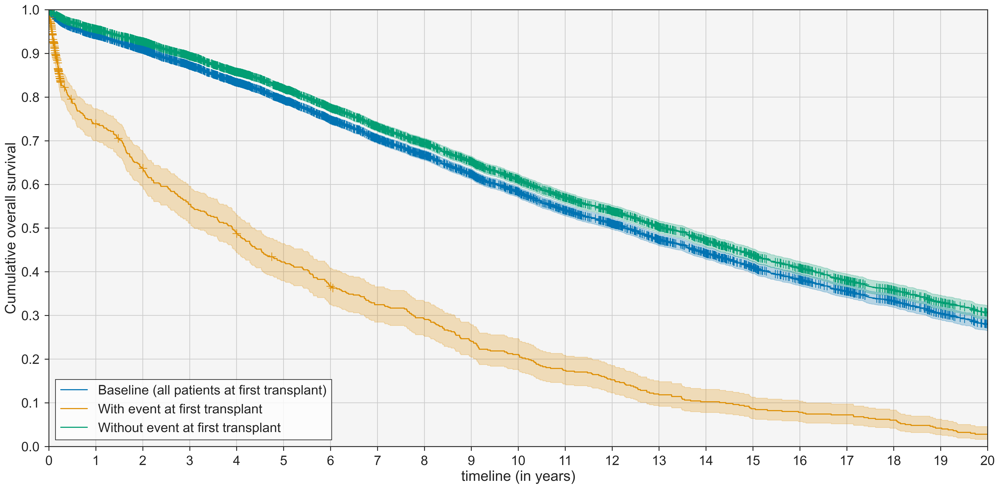

Median:  1426.0
30      0.935374
365     0.738697
730     0.636887
1095    0.554328
1825    0.422309
3650    0.210468
Name: KM_estimate, dtype: float64

Median:  4784.0
30      0.992014
365     0.955837
730     0.927208
1095    0.893572
1825    0.819340
3650    0.611446
Name: KM_estimate, dtype: float64


In [92]:
# 30-day mortality of first transplants with EGL or without EGL 
tx = ix_tx01
subset = ix_egl
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365*20
ylim = 0.0
filename = 'km-mort-tx01-egl-D{}-y{}'.format(days, int(ylim*10))
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='first')
compare_predictions(df, tx, subset, event=event, duration=duration)

Total:	 815
Years
Exported file:	 km-mort-tx2-D3650-y0


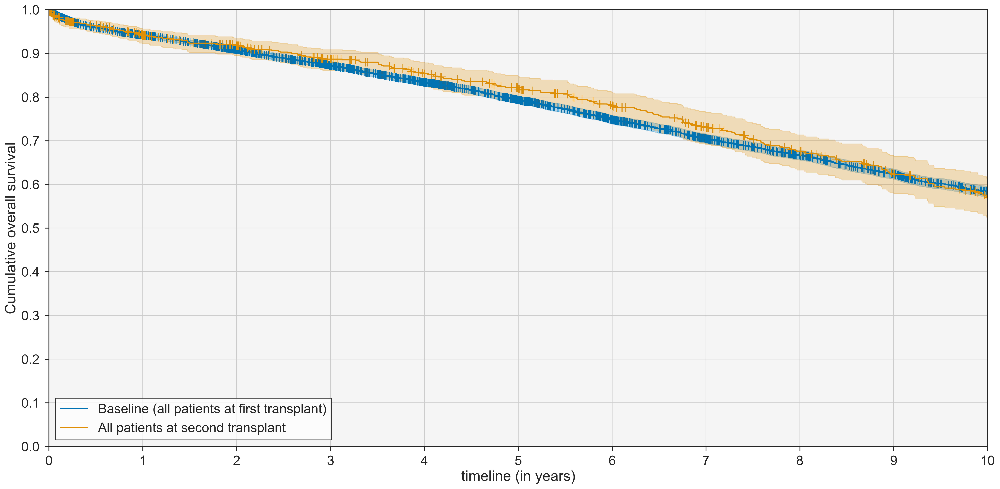

In [93]:
# 10-year Mortality of second transplant
tx = ix_tx2
subset = None
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365*10
ylim = 0.0
filename = 'km-mort-tx2-D{}-y{}'.format(days, int(ylim*10))
title = 'The Kaplan-Meier estimates for death within 10 years at second transplant'
plot_km(df, tx, subset=subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='second', title=title)

Total:	 815
Event:	 341
~Event:	 474
Years
Exported file:	 km-mort-tx2-egl_before-D3650-y0


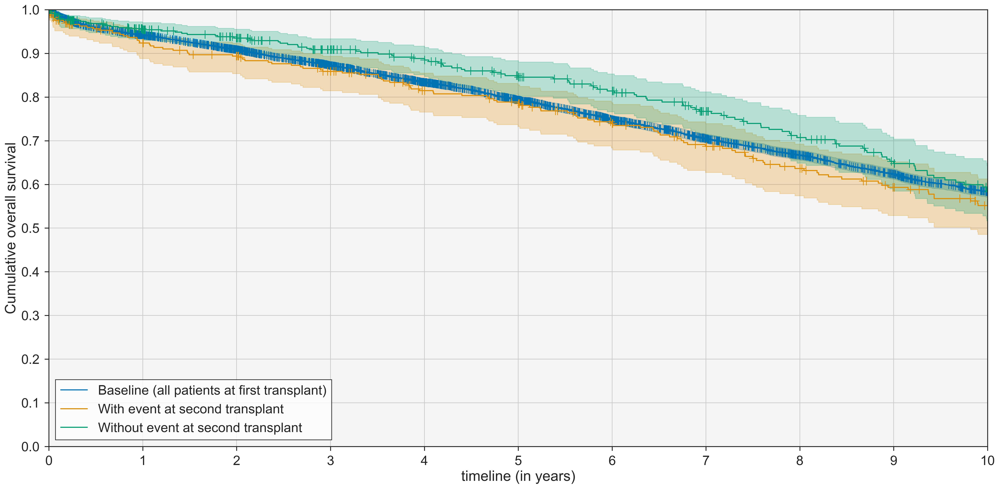

0       1.000000
365     0.923583
730     0.893609
1095    0.858823
1460    0.814799
1825    0.784689
2190    0.739363
2555    0.686898
2920    0.636351
3285    0.593053
3650    0.551394
Name: With event at second transplant, dtype: float64

In [94]:
# 10-year Mortality of second transplant with egl at first
tx = ix_tx2
subset = ix_egl_before
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365*10
ylim = 0.0
filename = 'km-mort-tx2-egl_before-D{}-y{}'.format(days, int(ylim*10))
title = 'The Kaplan-Meier estimates for death within 10 years at second transplant with EGL at first'
plot_km(df, tx, subset=subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='second', title=title)

In [95]:
predictions, median = predict_km(df, tx, subset, event=event, duration=duration)
print("Median: ", median)
predictions

Median:  4220.0


30      0.975447
365     0.923583
730     0.893609
1095    0.858823
1825    0.784689
3650    0.551394
Name: KM_estimate, dtype: float64

Total:	 9446
Event:	 809
~Event:	 8637
Exported file:	 km-mort-tx01-egl-D90-y8


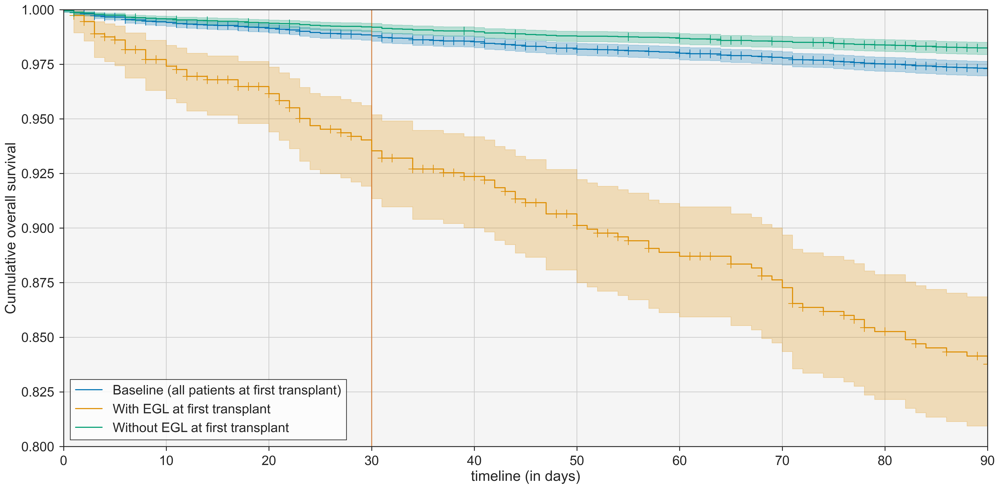

Median:  1426.0
30      0.935374
365     0.738697
730     0.636887
1095    0.554328
1825    0.422309
3650    0.210468
Name: KM_estimate, dtype: float64

Median:  4784.0
30      0.992014
365     0.955837
730     0.927208
1095    0.893572
1825    0.819340
3650    0.611446
Name: KM_estimate, dtype: float64


In [96]:
# 30-day mortality of first transplants with EGL or without EGL - PLOT IS IN PAPER
tx = ix_tx01
subset = ix_egl
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 90
ylim = 0.8
filename = 'km-mort-tx01-egl-D{}-y{}'.format(days, int(ylim*10))
title = 'The Kaplan-Meier estimates for death within 90 days at first transplant - with or without early graftloss'
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='first', title=title, subset_name='EGL')
compare_predictions(df, tx, subset, event=event, duration=duration)

Total:	 9446
Event:	 809
~Event:	 8637
Years
Exported file:	 km-mort-tx01-egl-D7300-y0


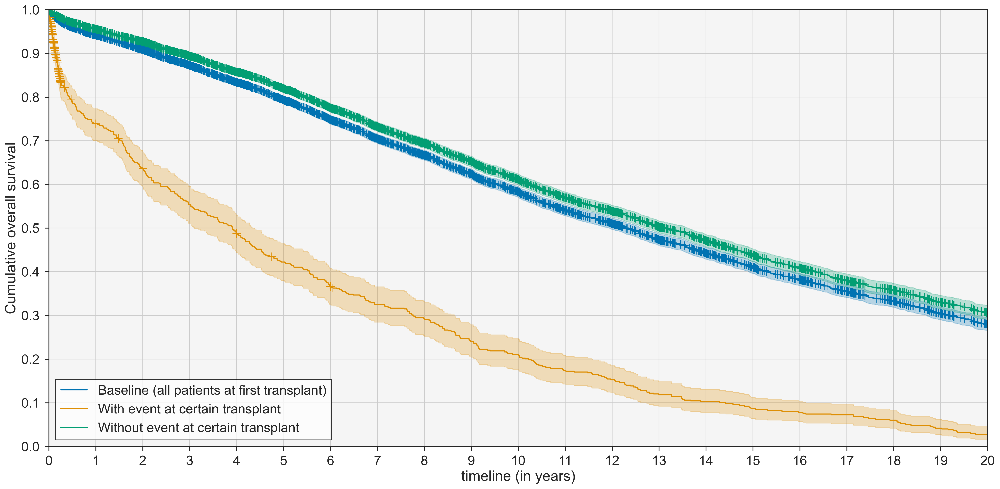

Median:  1426.0
30      0.935374
365     0.738697
730     0.636887
1095    0.554328
1825    0.422309
3650    0.210468
Name: KM_estimate, dtype: float64

Median:  4784.0
30      0.992014
365     0.955837
730     0.927208
1095    0.893572
1825    0.819340
3650    0.611446
Name: KM_estimate, dtype: float64


In [97]:
# 30-day mortality of first transplants with EGL or without EGL 
tx = ix_tx01
subset = ix_egl
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365*20
ylim = 0.0
filename = 'km-mort-tx01-egl-D{}-y{}'.format(days, int(ylim*10))
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename)
compare_predictions(df, tx, subset, event=event, duration=duration)

Total:	 815
Event:	 341
~Event:	 474
Exported file:	 km-mort-tx2-egl_first-D90-y93


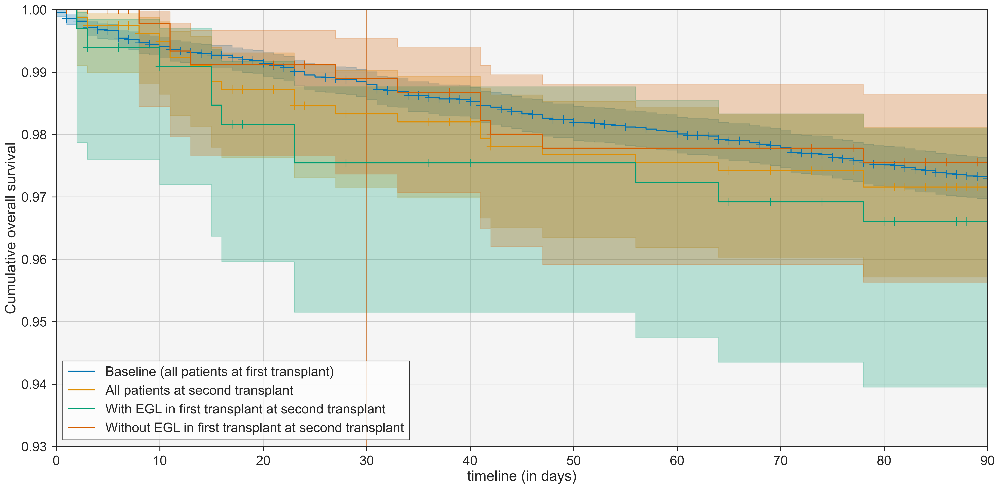

Median:  4220.0
30      0.975447
365     0.923583
730     0.893609
1095    0.858823
1825    0.784689
3650    0.551394
Name: KM_estimate, dtype: float64

Median:  4728.0
30      0.988948
365     0.954181
730     0.935187
1095    0.908404
1825    0.849057
3650    0.583049
Name: KM_estimate, dtype: float64


In [98]:
# 30-day mortality of second transplant with EGL at 1st tx or without EGL at 1st tx - PLOT IS IN PAPER
# (Average tx2 is shown above)
tx = ix_tx2
subset = ix_egl_first
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 90
ylim = 0.93
filename = 'km-mort-tx2-egl_first-D{}-y{}'.format(days, int(ylim*100))
title = 'The Kaplan-Meier estimates for death within 90 days at second transplant - with or without early graftloss at first transplant'
plot_km(df, tx, subset=subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename, tx_nr='second', title=title, subset_name='EGL in first transplant')
compare_predictions(df, tx, subset, event=event, duration=duration)

Total:	 815
Event:	 341
~Event:	 474
Years
Exported file:	 km-mort-tx2-egl_first-D3650-y0


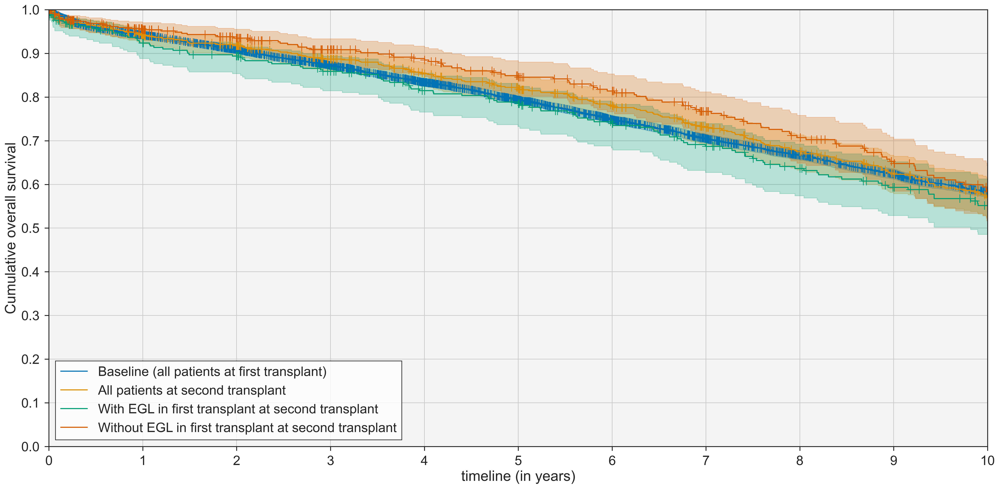

Median:  4220.0
30      0.975447
365     0.923583
730     0.893609
1095    0.858823
1825    0.784689
3650    0.551394
Name: KM_estimate, dtype: float64

Median:  4728.0
30      0.988948
365     0.954181
730     0.935187
1095    0.908404
1825    0.849057
3650    0.583049
Name: KM_estimate, dtype: float64


In [99]:
# Mortality of second transplant with EGL at 1st tx or without EGL at 1st tx - PLOT IS IN PAPER
# (Average tx2 is shown above)
tx = ix_tx2
subset = ix_egl_first
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365 * 10
ylim = 0.0
filename = 'km-mort-tx2-egl_first-D{}-y{}'.format(days, int(ylim*100))
title = 'The Kaplan-Meier estimates for death within 10 years at second transplant - with or without early graftloss at first transplant'
plot_km(df, tx, subset=subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename, tx_nr='second', title=title, subset_name='EGL in first transplant')
compare_predictions(df, tx, subset, event=event, duration=duration)

Total:	 815
Event:	 341
~Event:	 474
Years
Exported file:	 km-mort-tx2-egl_first-D7300-y0


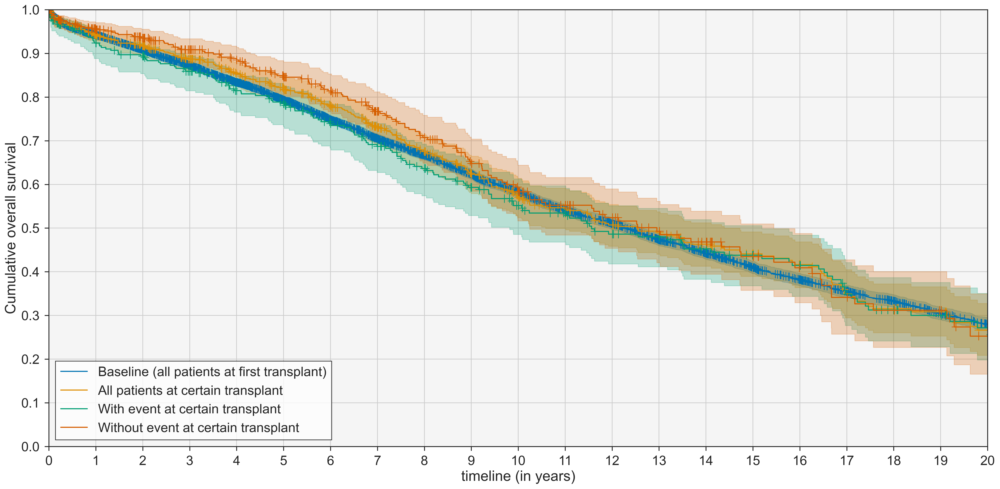

Median:  4220.0
30      0.975447
365     0.923583
730     0.893609
1095    0.858823
1825    0.784689
3650    0.551394
Name: KM_estimate, dtype: float64

Median:  4728.0
30      0.988948
365     0.954181
730     0.935187
1095    0.908404
1825    0.849057
3650    0.583049
Name: KM_estimate, dtype: float64


In [100]:
# 30-day mortality of second transplant with EGL at 1st tx or without EGL at 1st tx
# (Average tx2 is shown above)
tx = ix_tx2
subset = ix_egl_first
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365*20
ylim = 0.0
filename = 'km-mort-tx2-egl_first-D{}-y{}'.format(days, int(ylim*100))
plot_km(df, tx, subset=subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)
compare_predictions(df, tx, subset, event=event, duration=duration)

#### EGL-30

Total:	 9446
Event:	 600
~Event:	 8846
Years
Exported file:	 km-mort-tx01-egl-D365-y5


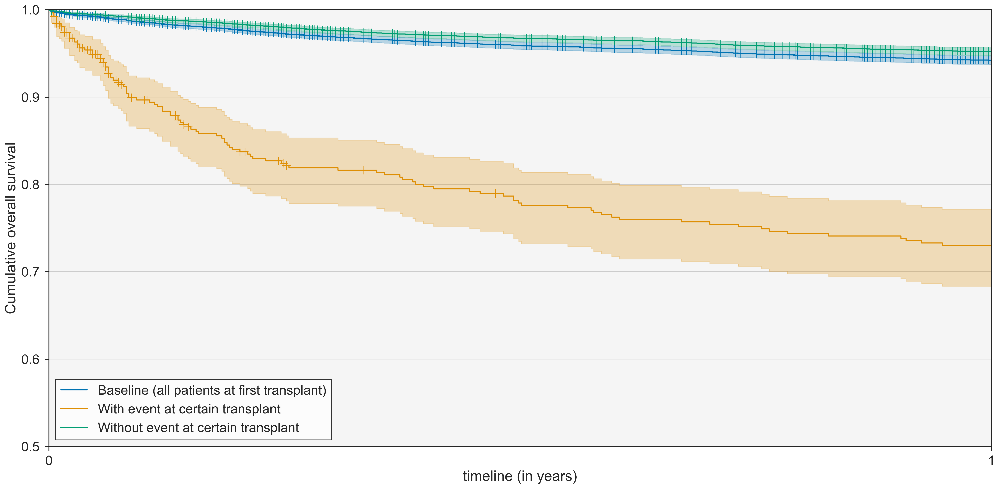

0      1.000000
365    0.730181
Name: With event at certain transplant, dtype: float64

In [101]:
# 30-day mortality of first transplants with EGL or without EGL 
tx = ix_tx01
subset = ix_egl_d30
event = 'r_dead' # 'graftloss'
duration = 'duration' # 'km_graft'
days = 365
ylim = 0.5
filename = 'km-mort-tx01-egl-D{}-y{}'.format(days, int(ylim*10))
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename)

### Graft Survival

Total:	 815
Years
Exported file:	 km-gs-tx2-Y20-y0


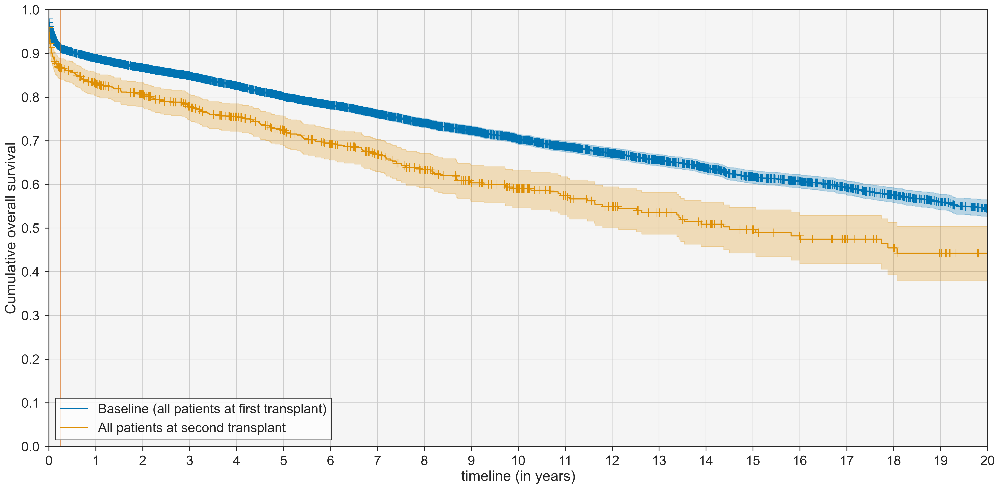

Median:  5292.0
30      0.894883
365     0.830272
730     0.807048
1095    0.778809
1825    0.723375
3650    0.590759
Name: KM_estimate, dtype: float64
Median:  8603.0


30      0.935744
365     0.888648
730     0.867015
1095    0.848708
1825    0.801176
3650    0.703616
Name: KM_estimate, dtype: float64

In [102]:
# How long a second transplants graft survives - PLOT IS IN PAPER
tx = ix_tx2
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*20
ylim = 0
filename = 'km-gs-tx2-Y{}-y{}'.format(int(days/365), int(ylim*100))
title = 'The Kaplan-Meier estimates for graftloss within 20 years at second transplant'
plot_km(df, tx, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename, tx_nr='second', title=title)

predictions, median = predict_km(df, tx, None, event=event, duration=duration)
print("Median: ", median)
print(predictions)

predictions, median = predict_km(df, ~tx, None, event=event, duration=duration)
print("Median: ", median)
predictions

In [103]:
# # How long a second transplants graft works with EGL or without EGL at first transplant
# tx = ix_tx2 & ~ix_egl
# event = 'graftloss' # 'r_dead' / 'graftloss'
# duration = 'km_graft' # 'duration' / 'km_graft'
# days = 365*20
# ylim = 0
# filename = 'km-gs-tx2-Y{}-y{}'.format(int(days/365), int(ylim*100))
# plot_km(df, tx, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)

Total:	 815
Event:	 341
~Event:	 474
Years
Exported file:	 km-gs-tx2-egl_first-Y20-y0


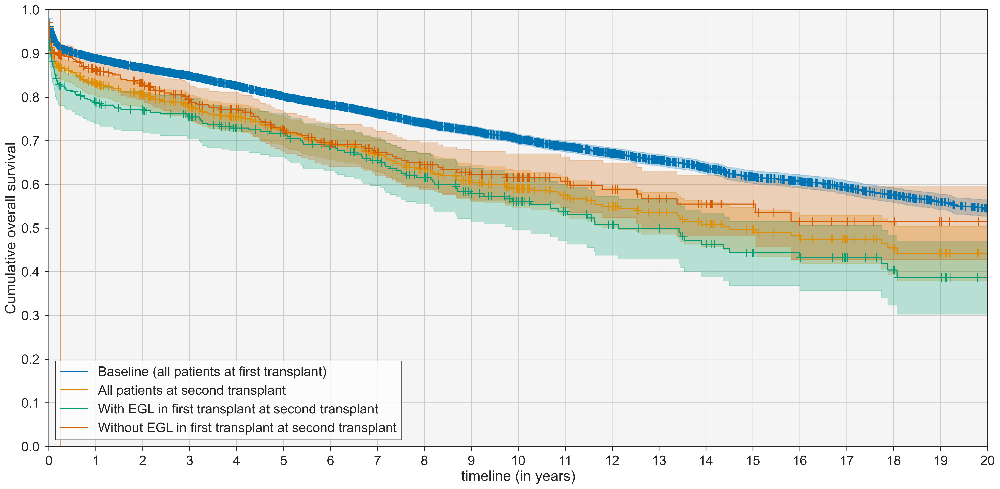

0       0.944282
365     0.787873
730     0.771713
1095    0.754541
1460    0.728877
1825    0.717245
2190    0.687626
2555    0.655306
2920    0.616004
3285    0.578744
3650    0.560492
4015    0.538461
4380    0.507566
4745    0.499379
5110    0.463023
5475    0.443320
5840    0.432765
6205    0.432765
6570    0.403914
6935    0.386352
7300    0.386352
Name: With EGL in first transplant at second transplant, dtype: float64

In [104]:
# How long a second transplants graft works with EGL or without EGL at first transplant - PLOT IS IN PAPER
tx = ix_tx2
subset = ix_egl_first
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*20
ylim = 0
filename = 'km-gs-tx2-egl_first-Y{}-y{}'.format(int(days/365), int(ylim*10))
title = 'The Kaplan-Meier estimates for graftloss within 20 years at second transplant - with or without graftloss'
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename, subset_name='EGL in first transplant', tx_nr='second', title=title)

In [105]:
 compare_predictions(df, tx, subset, event=event, duration=duration)

Median:  4430.0
30      0.873206
365     0.787873
730     0.771713
1095    0.754541
1825    0.717245
3650    0.560492
Name: KM_estimate, dtype: float64

Median:  inf
30      0.910480
365     0.860851
730     0.832022
1095    0.794662
1825    0.723098
3650    0.615926
Name: KM_estimate, dtype: float64


In [106]:
predictions, median = predict_km(df, tx, ~subset, event=event, duration=duration)
print("Median: ", median)
print(predictions)

Median:  inf
30      0.910480
365     0.860851
730     0.832022
1095    0.794662
1825    0.723098
3650    0.615926
Name: KM_estimate, dtype: float64


Total:	 9446
Event:	 815
~Event:	 8631
Years
Exported file:	 km-gs-tx01-tx_after-Y20-y0


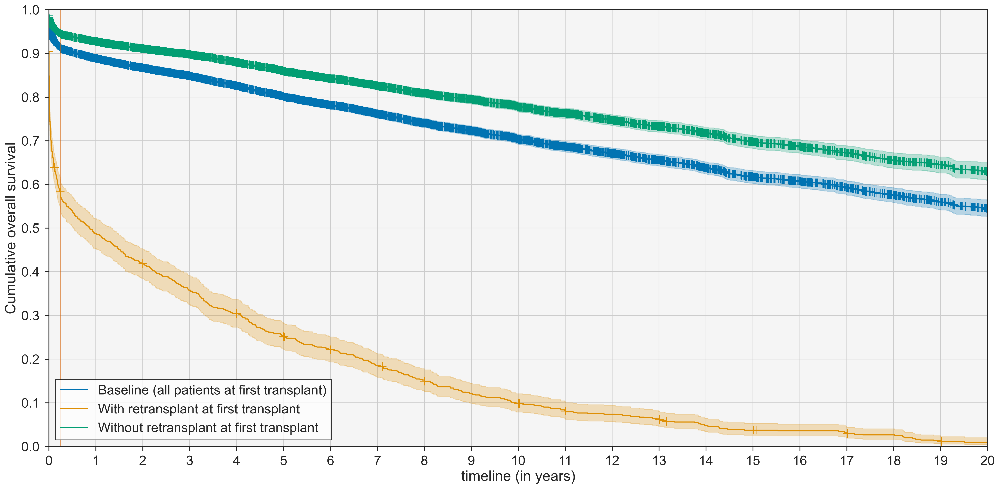

0       0.904294
365     0.487478
730     0.419256
1095    0.358118
1460    0.304462
1825    0.251839
2190    0.221325
2555    0.184224
2920    0.149448
3285    0.120607
3650    0.098321
4015    0.082159
4380    0.073963
4745    0.061636
5110    0.047383
5475    0.037332
5840    0.035776
6205    0.029554
6570    0.026271
6935    0.011493
7300    0.007662
Name: With retransplant at first transplant, dtype: float64

In [107]:
# How long a graft works if a person has a retransplant afterwards
# (thus taking only "completed" grafts) - PLOT IS IN PAPER
tx = ix_tx01
subset = ix_retransplant_after
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*20
ylim = 0
filename = 'km-gs-tx01-tx_after-Y{}-y{}'.format(int(days/365), ylim)
title = 'The Kaplan-Meier estimates for graftloss within 20 years at first transplant - with or without retransplant'
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='first', title=title, subset_name='retransplant')

Total:	 5366
Event:	 516
~Event:	 4850
Years
Exported file:	 km-gs-tx01&~dead-tx_after-Y20-y0


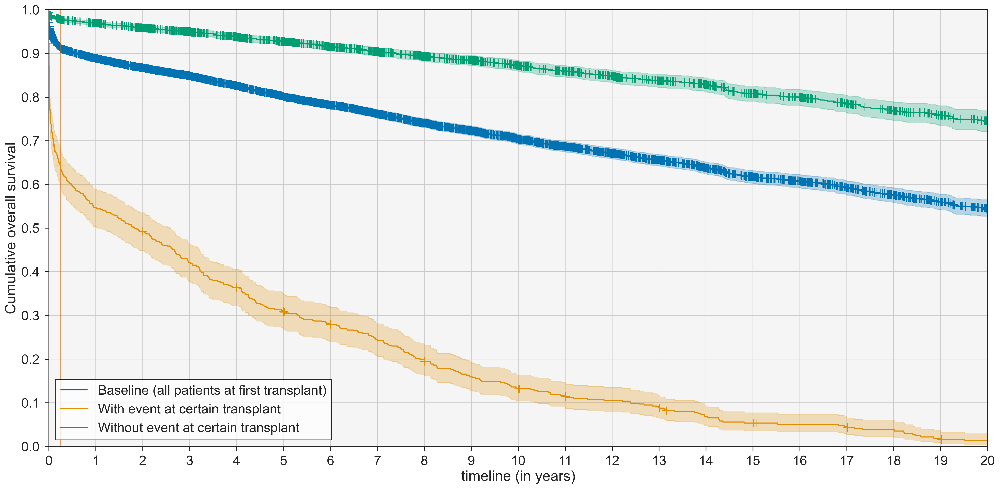

0       0.922481
365     0.547713
730     0.492548
1095    0.421049
1460    0.363453
1825    0.309534
2190    0.279012
2555    0.242084
2920    0.194898
3285    0.159271
3650    0.132028
4015    0.116877
4380    0.105889
4745    0.088240
5110    0.067489
5475    0.053526
5840    0.050977
6205    0.043331
6570    0.037914
6935    0.016249
7300    0.009749
Name: With event at certain transplant, dtype: float64

In [108]:
# How long a graft works if a person has a retransplant afterwards and did not die
# (thus taking only "completed" grafts that made it till the end)
tx = ix_tx01 & ~ix_dead
subset = ix_retransplant_after
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*20
ylim = 0
filename = 'km-gs-tx01&~dead-tx_after-Y{}-y{}'.format(int(days/365), ylim)
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename)

Total:	 8637
Event:	 474
~Event:	 8163
Years
Exported file:	 km-gs-tx01-negl-tx_after-Y20-y0


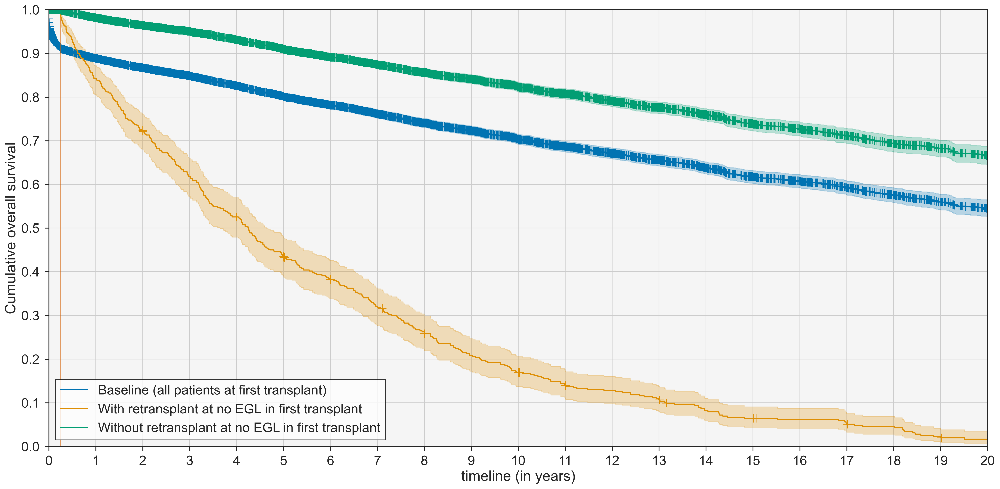

0       1.000000
365     0.841542
730     0.723769
1095    0.618225
1460    0.525599
1825    0.434754
2190    0.382076
2555    0.318029
2920    0.257994
3285    0.208206
3650    0.169733
4015    0.141832
4380    0.127684
4745    0.106403
5110    0.081798
5475    0.064447
5840    0.061761
6205    0.051020
6570    0.045351
6935    0.019841
7300    0.013227
Name: With retransplant at no EGL in first transplant, dtype: float64

In [109]:
# How long a graft works if a person has a retransplant afterwards and did not have early graftloss
# (thus taking only "completed" grafts that did not fail in the beginning) - PLOT IS IN PAPER
tx = ix_tx01 & ~ix_egl
subset = ix_retransplant_after
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*20
ylim = 0
filename = 'km-gs-tx01-negl-tx_after-Y{}-y{}'.format(int(days/365), ylim)
title = 'The Kaplan-Meier estimates for graftloss within 20 years at first transplant without early graftloss - with or without retransplant afterwards'
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, tx_nr='no EGL in first', subset_name='retransplant', title=title)

Total:	 303
Event:	 87
~Event:	 216
Years
Exported file:	 km-gs-tx2-egl_first-Y10-y0


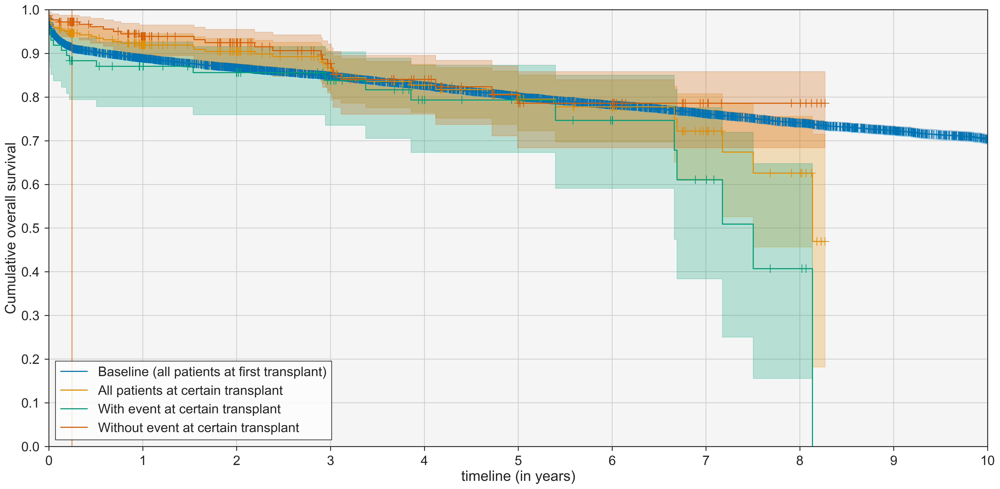

0       0.954023
365     0.870552
730     0.855797
1095    0.837968
1460    0.793154
1825    0.793154
2190    0.746498
2555    0.610771
2920    0.407181
3285    0.000000
3650    0.000000
Name: With event at certain transplant, dtype: float64

In [110]:
# Graft survival at second transplant when graftloss at first
tx = ix_tx2 & ix_year_after[2008]
subset = ix_egl_first
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365*10
ylim = 0
filename = 'km-gs-tx2-egl_first-Y{}-y{}'.format(int(days/365), ylim)
plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, average=True)

#### EGL-30

Total:	 542
Years
Exported file:	 km-gs-tx2-Y1-y0


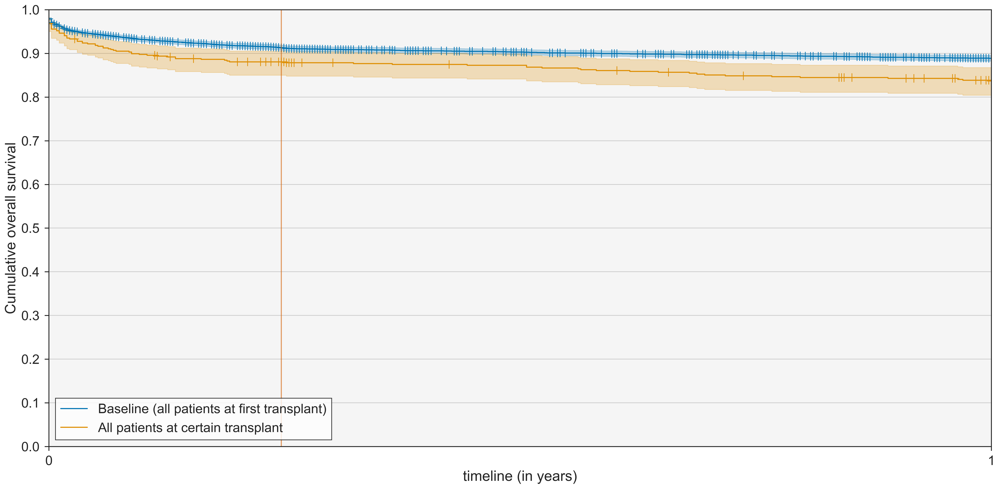

(30      0.874786
 365     0.817740
 730     0.801645
 1095    0.784582
 1825    0.743503
 3650    0.576315
 Name: KM_estimate, dtype: float64,
 4942.0)

In [111]:
# How long a second transplants graft works with EGL or without EGL at first transplant
tx = ix_tx2 & ~ix_egl_before_d30
not_tx = ix_tx2 & ix_egl_before_d30
event = 'graftloss' # 'r_dead' / 'graftloss'
duration = 'km_graft' # 'duration' / 'km_graft'
days = 365
ylim = 0
filename = 'km-gs-tx2-Y{}-y{}'.format(int(days/365), int(ylim*100))
plot_km(df, tx, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)
predict_km(df, not_tx, event=event, duration=duration)

### Retransplant days

Total:	 815
Event:	 341
~Event:	 474
Years
Exported file:	 km-rt-tx0-Y10-y0


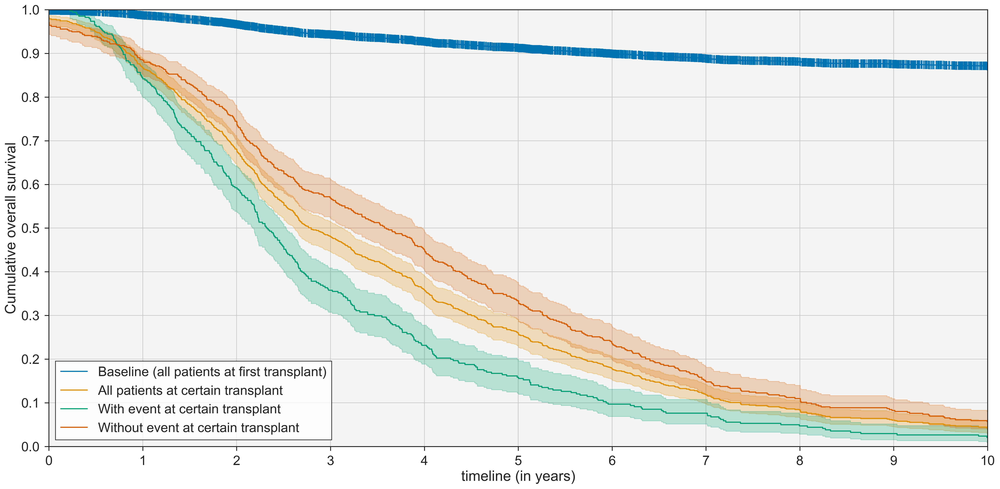

0       1.000000
365     0.841642
730     0.592375
1095    0.357771
1460    0.231672
1825    0.158358
2190    0.096774
2555    0.076246
2920    0.046921
3285    0.029326
3650    0.020528
Name: With event at certain transplant, dtype: float64

In [112]:
# How long it takes for a person to receive a retransplant
tx = ix_tx1 & ix_retransplant_after
subset = ix_egl
event = 'retransplant' # 'r_dead' / 'graftloss'
duration = 'km_retransplant_wait' # 'duration' / 'km_graft'
days = 365*10
ylim = 0.0
filename = 'km-rt-tx0-Y{}-y{}'.format(int(days/365), int(ylim*100))
predictions = plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)
predictions

Total:	 516
Event:	 184
~Event:	 332
Years
Exported file:	 km-rt-tx0-Y10-y0


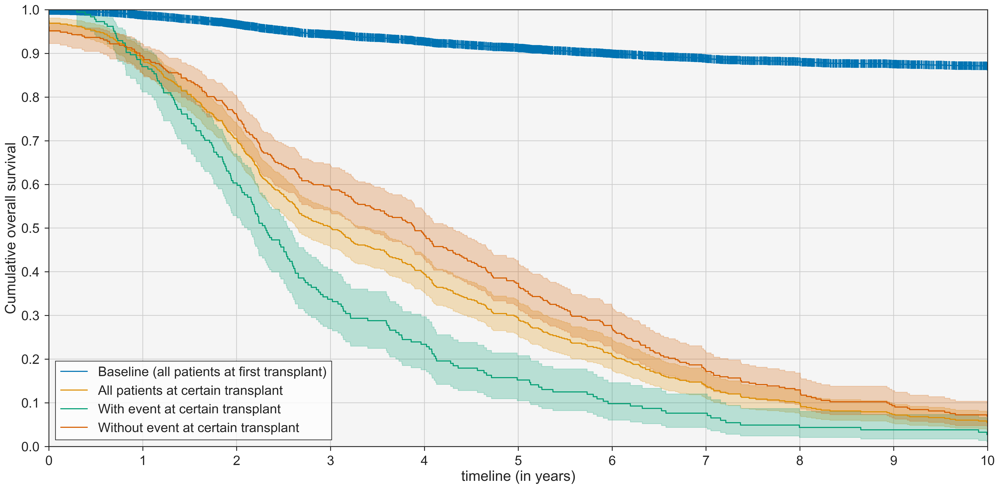

0       1.000000
365     0.869565
730     0.603261
1095    0.336957
1460    0.233696
1825    0.152174
2190    0.097826
2555    0.076087
2920    0.043478
3285    0.038043
3650    0.027174
Name: With event at certain transplant, dtype: float64

In [113]:
# How long it takes for a person to receive a retransplant
tx = ix_tx1 & ix_retransplant_after & ~ix_dead
subset = ix_egl
event = 'retransplant' # 'r_dead' / 'graftloss'
duration = 'km_retransplant_wait' # 'duration' / 'km_graft'
days = 365*10
ylim = 0.0
filename = 'km-rt-tx0-Y{}-y{}'.format(int(days/365), int(ylim*100))
predictions = plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)
predictions

In [114]:
# # How long it takes for a person to receive a retransplant - INCORRECT
# tx = ix_tx1 & ix_retransplant
# subset = ix_egl
# event = 'retransplant' # 'r_dead' / 'graftloss'
# duration = 'duration_rt' # 'duration' / 'km_graft' / 'km_retransplant_wait'
# days = 365*10
# ylim = 0.0
# filename = 'km-rt-tx0-Y{}-y{}'.format(int(days/365), int(ylim*100))
# predictions = plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, average=True, filename=filename)

Total:	 1322
Event:	 495
~Event:	 827
Years
Exported file:	 km-rt-tx0-Y10-y0


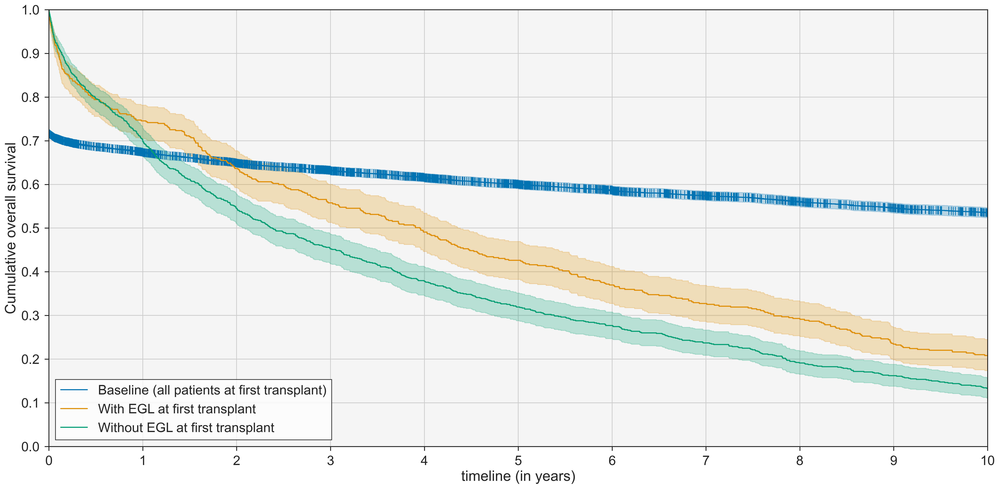

0       1.000000
365     0.745455
730     0.636364
1095    0.557576
1460    0.490909
1825    0.426263
2190    0.369697
2555    0.327273
2920    0.290909
3285    0.234343
3650    0.208081
Name: With EGL at first transplant, dtype: float64

In [115]:
# How long it takes for a person to die after their graft fails
tx = ix_tx01 & df['fail_death_diff'] != 0
subset = ix_egl
event = 'r_dead' # 'r_dead' / 'graftloss'
duration = 'km_fail_death_diff' # 'duration' / 'km_graft'
days = 365*10
ylim = 0.0
filename = 'km-rt-tx0-Y{}-y{}'.format(int(days/365), int(ylim*100))
predictions = plot_km(df, tx, subset, event=event, duration=duration, days=days, ylim=ylim, filename=filename, subset_name='EGL', tx_nr='first')
predictions

## Bar Plots

In [116]:
# Create a bar plot for each year
def plot_bar_year(x, y, title=None, hval=None, line=False):
    plt.figure(figsize=(16,4))
    plt.bar(x, y)
#     if title: plt.title(title)
    if hval: plt.axhline(hval, ls='dashed', alpha=0.5)
    plt.grid(True, axis='y')
    plt.ylabel('percentage (%)')
    plt.xlabel('year')
    if title == 'Percentage early graftloss each year':
        plt.yticks(np.arange(0, 17.5, step=2.5))
    if line: 
        plt.plot(x, y, color='k')
    plt.tight_layout()
    if export:
        filename = 'bar-year-{}'.format(title)
        if hval: filename += '-N'
        plt.savefig("plots/{}.png".format(filename))
        print("Exported file:\t", filename)
    plt.show()

In [117]:
# Create a stacked bar plot for each year
def plot_bar_year_stacked(x, y, keys, title=None, hval=None):
    plt.figure(figsize=(16,4))
    bottom = np.zeros(28)
    for i, stack in enumerate(y):
        plt.bar(x, stack, bottom=bottom, label=keys[i])
        bottom += np.array(stack)
    if title: plt.title(title)
    if len(y) == 2 and hval is not None: plt.axhline(hval, ls='dashed', alpha=0.5)
    plt.legend(bbox_to_anchor=[1,1], frameon=True, fancybox=False, edgecolor='black')
    plt.grid(True, axis='y')
#     plt.ylabel('percentage')
#     plt.xlabel('year')
    if export:
        filename = 'bar-year-{}'.format(title)
        if hval: filename += '-N'
        plt.savefig("plots/{}.png".format(filename))
        print("Exported file:\t", filename)
    plt.show()

In [118]:
def plot_years_stacked(column, normalize=True):
    # Initialize ndarray
    nums = []
    keys = []
    unique = df[column].unique()
    for u in unique:
        nums.append([])    
    
    # Print overall distribution if normalized
    if normalize:
        print("Values:\t")
        total_values = df[column].value_counts(normalize=True)
        print(round(total_values*100,2))
    
    # Calculate yearly distribution
    for year in years:
        values = df[ix_year[year]][column].value_counts(normalize=normalize)
        total = values.sum()
        for i, u in enumerate(unique):
            if u in values:
                nums[i].append(values[u])
            else:
                nums[i].append(0)    
            keys.append(u)
    
    # Set horizontal line value if normalized
    if normalize: hval = total_values[total_values.index.tolist()[0]]
    else: hval = None
    
    # Plot distribution
    plot_bar_year_stacked(years, nums, keys, column, hval=hval)

In [119]:
def plot_years_mean(column, hline=True):
    mean = df[column].mean()
    print("Overall mean:\t", round(mean,2))
    values = []
    for year in years:
        value = df[ix_year[year]][column].mean()
        values.append(value)

    plot_bar_year(years, values, title=column, hval=mean, line=hline)

### 30-day mortality plots

In [120]:
def plot_years_single(column, normalize=True, key=1, line=False, title=None):
    # Initialize
    nums = []
    unique = df[column].unique()
    
    # Print overall distribution if normalized
    if normalize:
        print("Values:\t")
        total_values = df[column].value_counts(normalize=True)
        print(round(total_values*100,2))
    
    # Calculate yearly distribution
    for year in years:
        values = 100 * df[ix_year[year]][column].value_counts(normalize=normalize)
        total = values.sum()
        for i, u in enumerate(unique):
            if i == key:
                nums.append(values[u])
    
    # Set horizontal line value if normalized
    if normalize: hval = 100 * total_values[total_values.index.tolist()[key]]
    else: hval = None
        
    if title == None: title = column
    
    # Plot distribution
    plot_bar_year(years, nums, title=title, hval=hval, line=line)

Values:	
0    98.8
1     1.2
Name: mort, dtype: float64
Exported file:	 bar-year-mort-N


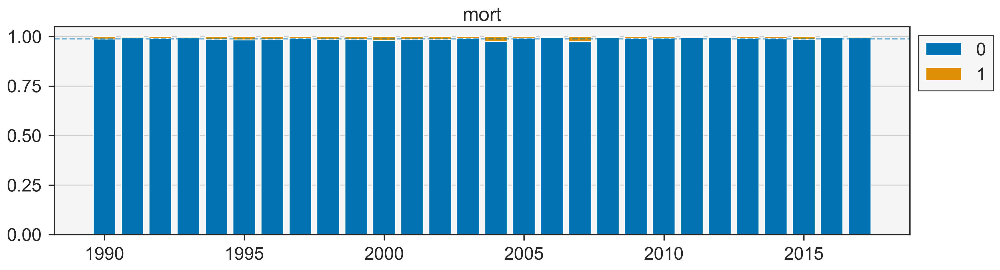

Exported file:	 bar-year-mort


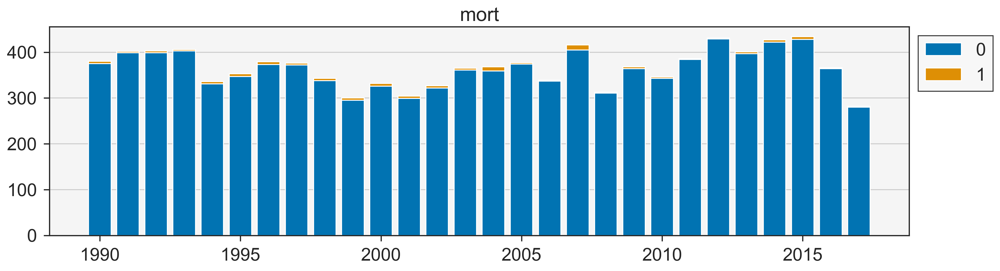

In [121]:
column = 'mort'
plot_years_stacked(column)
plot_years_stacked(column, normalize=False)

Values:	
0    98.8
1     1.2
Name: mort, dtype: float64
Exported file:	 bar-year-mort-N


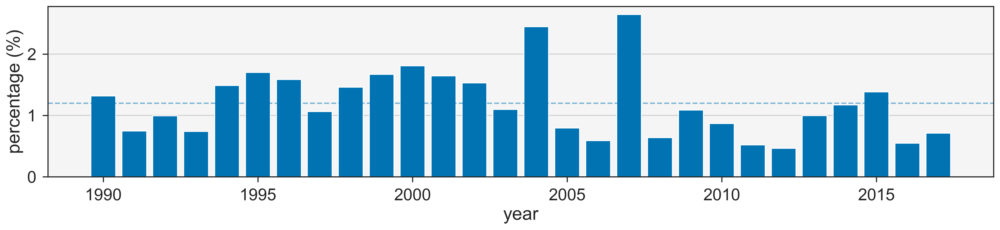

Values:	
0    98.8
1     1.2
Name: mort_d30, dtype: float64
Exported file:	 bar-year-mort_d30-N


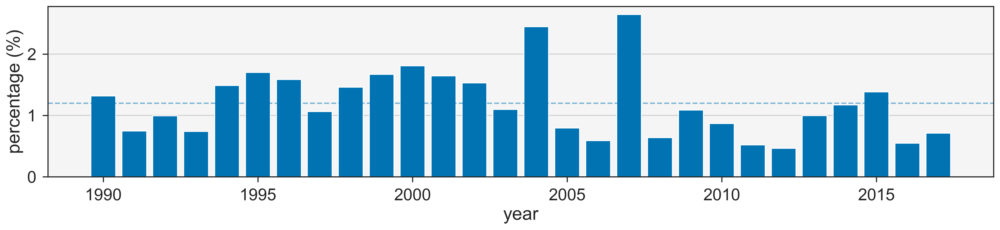

Values:	
0    94.56
1     5.44
Name: mort_y1, dtype: float64
Exported file:	 bar-year-mort_y1-N


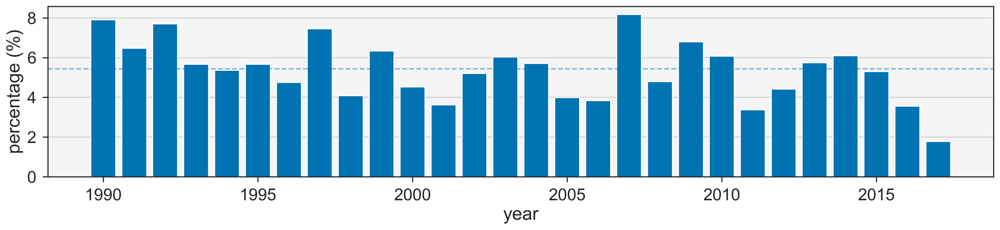

Values:	
0    83.05
1    16.95
Name: mort_y5, dtype: float64
Exported file:	 bar-year-mort_y5-N


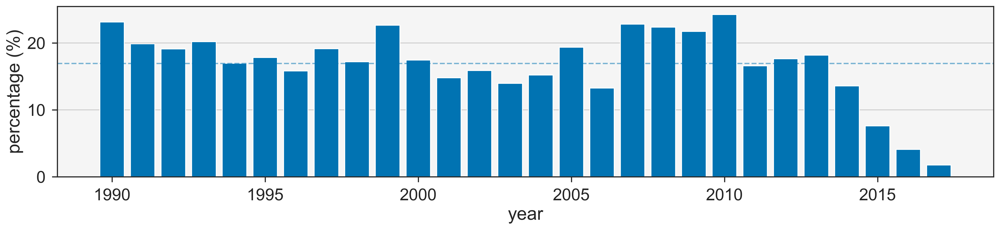

Values:	
0    91.07
1     8.93
Name: early_graftloss, dtype: float64
Exported file:	 bar-year-Percentage early graftloss each year-N


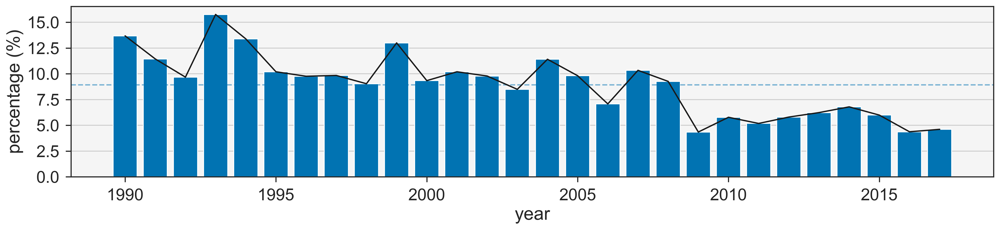

In [122]:
plot_years_single('mort')
plot_years_single('mort_d30')
plot_years_single('mort_y1')
plot_years_single('mort_y5')
plot_years_single('early_graftloss', line=True, title='Percentage early graftloss each year') # PLOT IS IN PAPER

In [123]:
def plot_years_double(column1, column2, normalize=True, key1=1, key2=1):
    # Initialize
    nums1 = []
    nums2 = []
    unique1 = df[column1].unique()
    unique2 = df[column2].unique()
    
    # Print overall distribution if normalized
    if normalize:
        print(column1, "Values1:\t")
        total_values1 = df[column1].value_counts(normalize=True)
        print(round(total_values1*100,2))
        print(column2, "Values2:\t")
        total_values2 = df[column2].value_counts(normalize=True)
        print(round(total_values2*100,2))
    
    # Calculate yearly distribution
    for year in years:
        values1 = 100 * df[ix_year[year]][column1].value_counts(normalize=normalize)
        for i, u in enumerate(unique1):
            if i == key1:
                nums1.append(values1[u])
                
        values2 = 100 * df[ix_year[year]][column2].value_counts(normalize=normalize)
        for i, u in enumerate(unique2):
            if i == key2:
                nums2.append(values2[u])
    
    # Set horizontal line value if normalized
    total_values1 = 100 * df[column1].value_counts(normalize=True)
    total_values2 = 100 * df[column2].value_counts(normalize=True)
    if normalize: 
        hval1 = total_values1[total_values1.index.tolist()[key1]]
        hval2 = total_values2[total_values2.index.tolist()[key2]]
    else: 
        hval1 = None
        hval2 = None
    
    # Plot distribution
    plot_bar_year_double(years, nums1, nums2, column1, column2, hval1=hval1, hval2=hval2)

In [124]:
# Create a bar plot for each year
def plot_bar_year_double(x, y1, y2, column1, column2, hval1=None, hval2=None):
    fig, ax1 = plt.subplots(figsize=(16,6))
    
    color = 'tab:red'
    width = 0.3
    ax1.set_xlabel('year')
    ax1.set_ylabel(column1, color=color)
    ax1.bar(x, y1, width, color=color)
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_ylim(top=30)
    ax1.locator_params(axis='y', nbins=10)
    if hval1: ax1.axhline(hval1, ls='dashed', alpha=0.5, color=color)
    
    ax1.grid(True, axis='y')
    ax2 = ax1.twinx()

    color = 'tab:blue'
    ax2.bar(np.array(x)+width, y2, width, color=color)
    ax2.set_ylabel(column2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.set_ylim(top=3)
    ax2.locator_params(axis='y', nbins=10)
    if hval2: ax2.axhline(hval2, ls='dashed', alpha=0.5, color=color)
    
    plt.title(f"Percentage of {column1} and {column2}")
    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    
    if export:
        filename = 'bar-year-double-{}&{}'.format(column1, column2)
        if hval1 or hval2: filename += '-N'
        plt.savefig("plots/{}.png".format(filename))
        print("Exported file:\t", filename)
    plt.show()

early_graftloss Values1:	
0    91.07
1     8.93
Name: early_graftloss, dtype: float64
mort Values2:	
0    98.8
1     1.2
Name: mort, dtype: float64
Exported file:	 bar-year-double-early_graftloss&mort-N


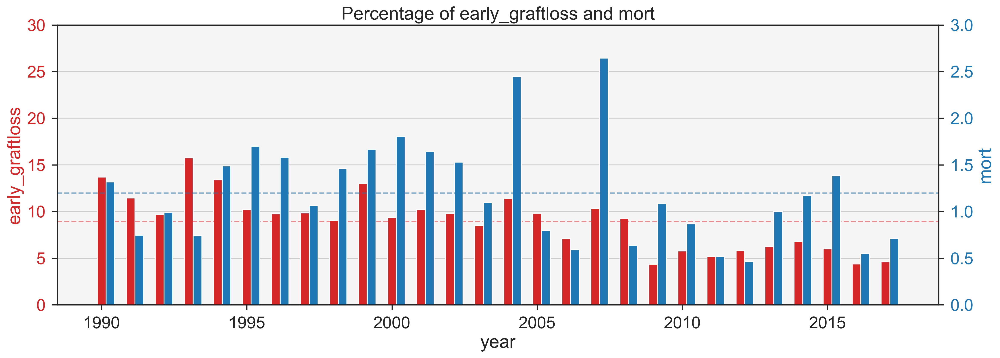

In [125]:
plot_years_double('early_graftloss', 'mort') # plot should be in paper

### Donor Both

In [126]:
# Calculate what percentage of the donors donates both kidneys
def donor_both(data):
    mean = data['d_id'].value_counts().mean()
    percentage = round((mean-1) * 100, 2)
#     print("Donor both:\t", percentage, "%")
    return mean - 1

Donor both average:	 39.02 %
Exported file:	 bar-year-Donor both-N


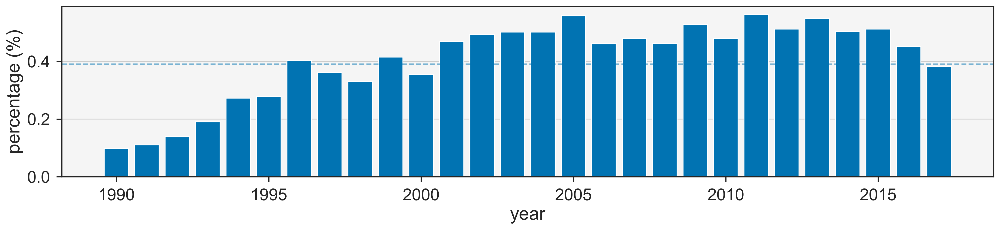

In [127]:
mean = df['d_id'].value_counts().mean()-1
print("Donor both average:\t", round(100*mean,2), "%")

values = []
for year in years:
#     print(year, end="\t")
    value = donor_both(df[ix_year[year]])
    values.append(value)
    
plot_bar_year(years, values, title='Donor both', hval=mean)

## Numerical means plots

Overall mean:	 50.39
Exported file:	 bar-year-r_age-N


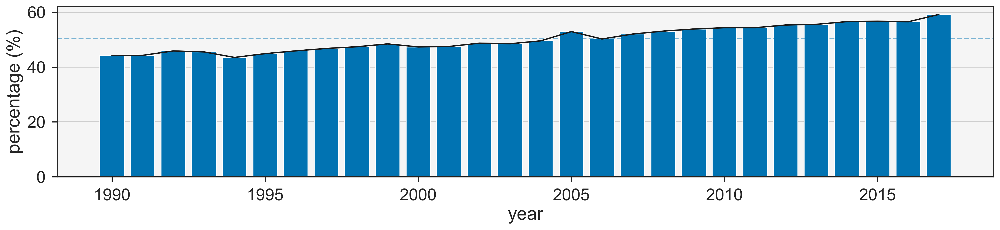

Overall mean:	 46.4
Exported file:	 bar-year-d_age-N


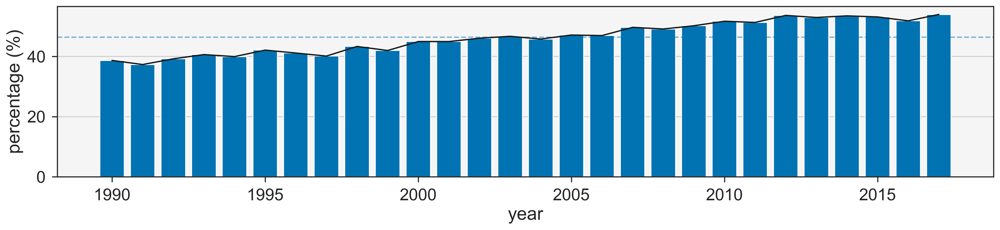

Overall mean:	 25.18
Exported file:	 bar-year-r_BMI-N


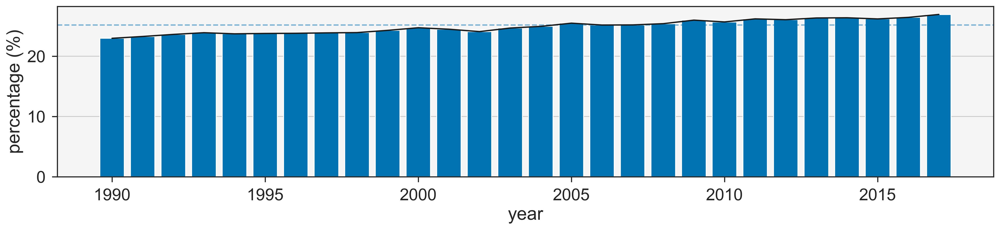

Overall mean:	 24.83
Exported file:	 bar-year-d_BMI-N


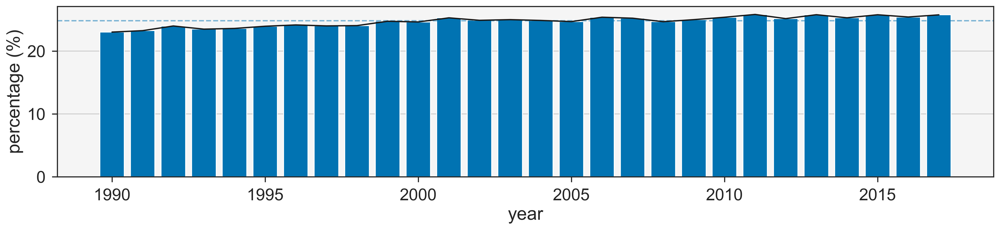

Overall mean:	 101.61
Exported file:	 bar-year-d_MDRD-N


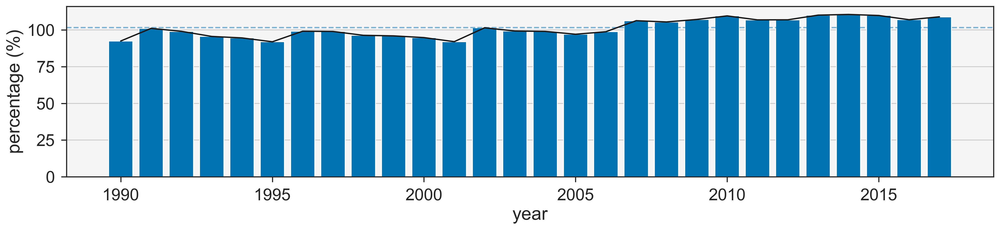

Overall mean:	 46.15
Exported file:	 bar-year-r_MDRD_M3-N


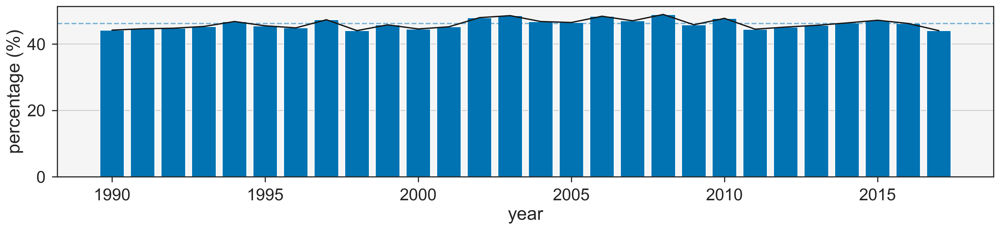

Overall mean:	 48.62
Exported file:	 bar-year-r_MDRD_Y1-N


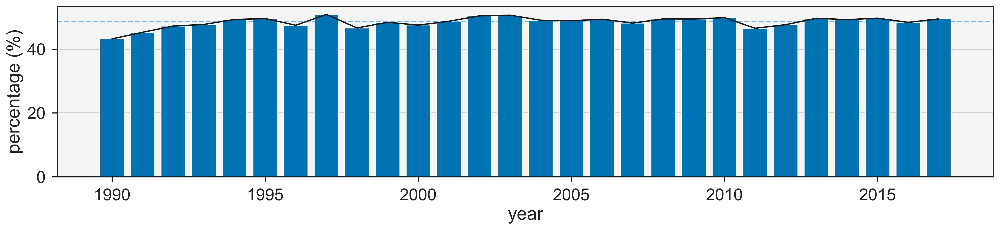

Overall mean:	 48.73
Exported file:	 bar-year-r_MDRD_Y5-N


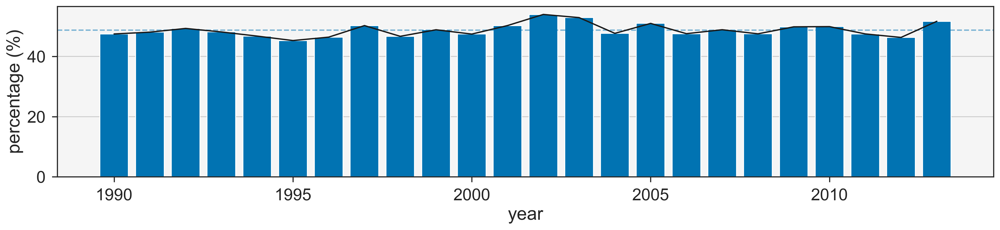

Overall mean:	 171.17
Exported file:	 bar-year-r_height-N


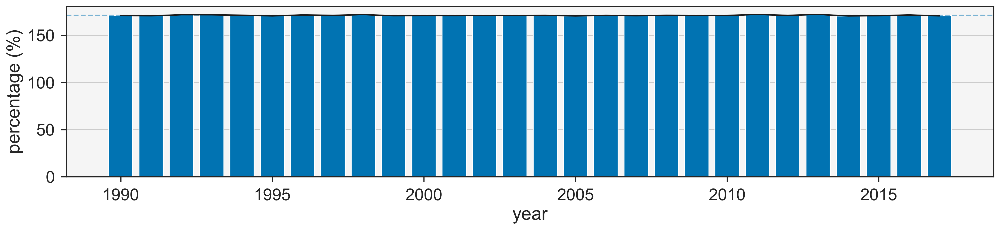

Overall mean:	 173.34
Exported file:	 bar-year-d_height-N


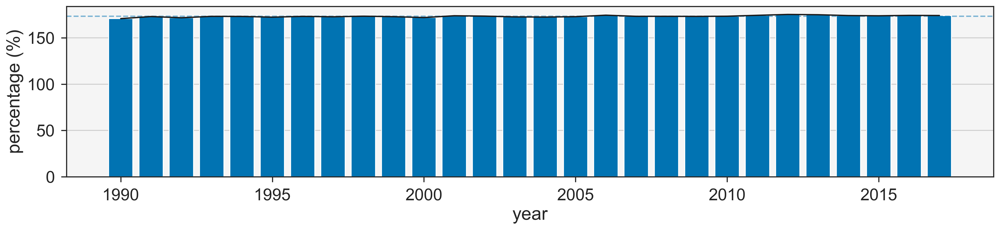

Overall mean:	 73.9
Exported file:	 bar-year-r_weight-N


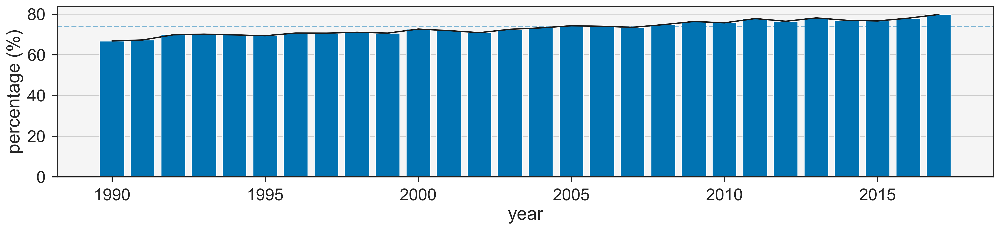

Overall mean:	 75.22
Exported file:	 bar-year-d_weight-N


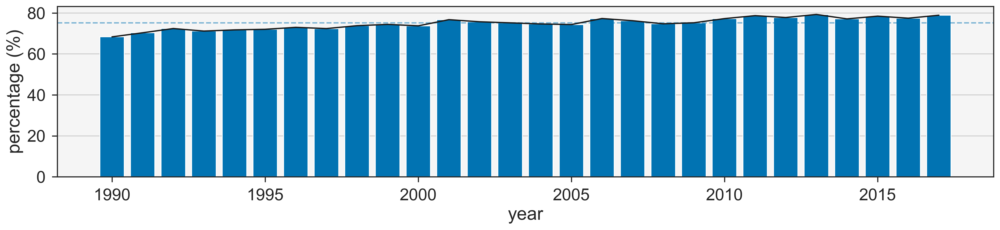

Overall mean:	 1243.57
Exported file:	 bar-year-ischaemic_period_cold-N


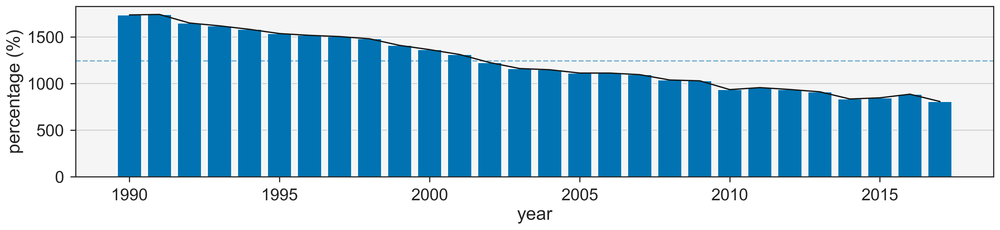

Overall mean:	 5.83
Exported file:	 bar-year-ischaemic_period_warm_1-N


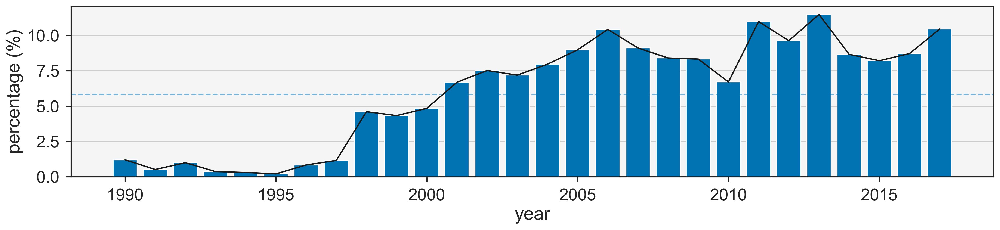

Overall mean:	 34.77
Exported file:	 bar-year-ischaemic_period_warm_2-N


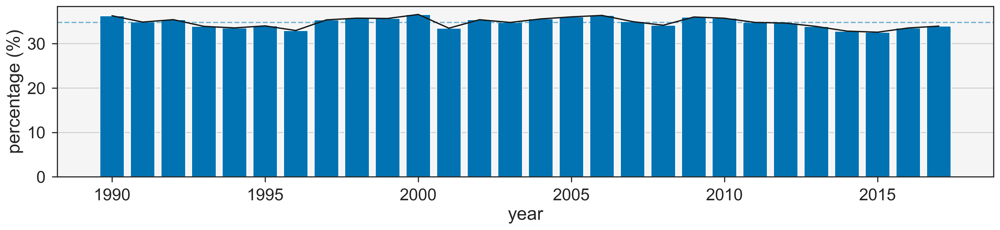

In [128]:
for ctype in numerical_types:
    for column in column_types[ctype]:
        plot_years_mean(column)

## Distributions plots

### Binary

Column:	d_sex
Values:	
0    54.0
1    46.0
Name: d_sex, dtype: float64
Exported file:	 bar-year-d_sex-N


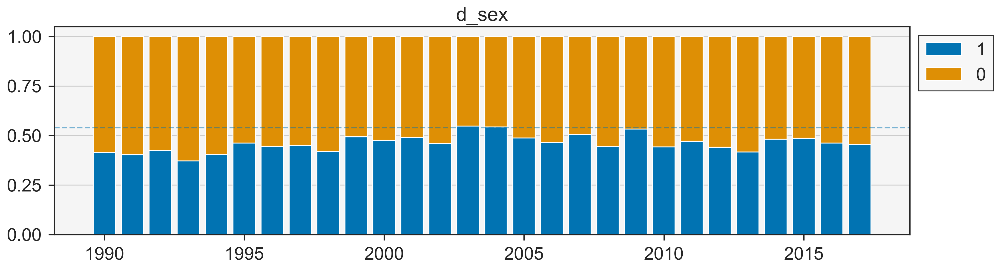

Exported file:	 bar-year-d_sex


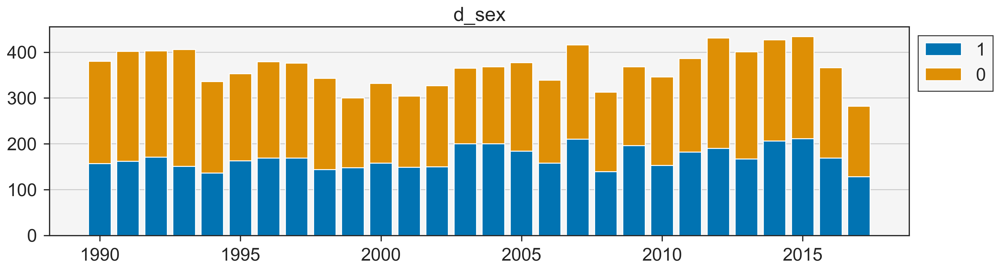

Column:	d_cardiac_arrest
Values:	
0.0    69.49
1.0    30.51
Name: d_cardiac_arrest, dtype: float64
Exported file:	 bar-year-d_cardiac_arrest-N


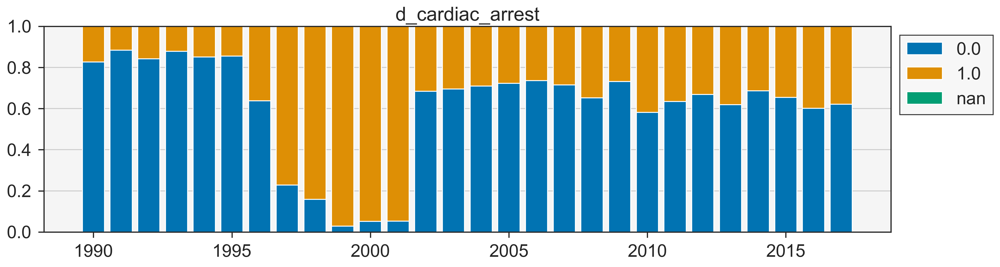

Exported file:	 bar-year-d_cardiac_arrest


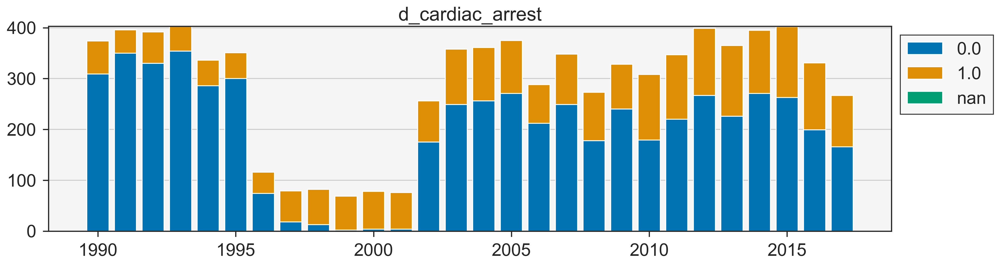

Column:	d_cadaveric_type
Values:	
1    70.48
0    29.52
Name: d_cadaveric_type, dtype: float64
Exported file:	 bar-year-d_cadaveric_type-N


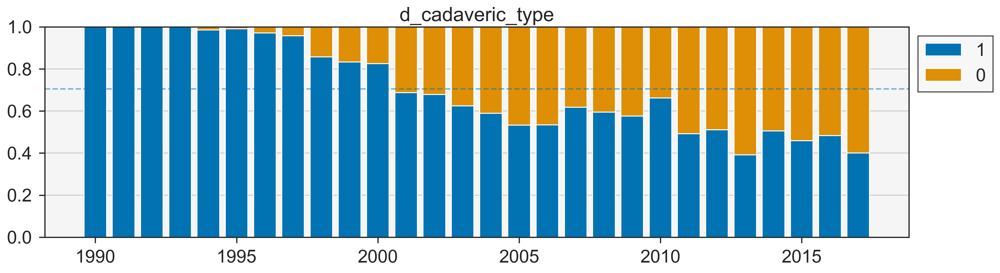

Exported file:	 bar-year-d_cadaveric_type


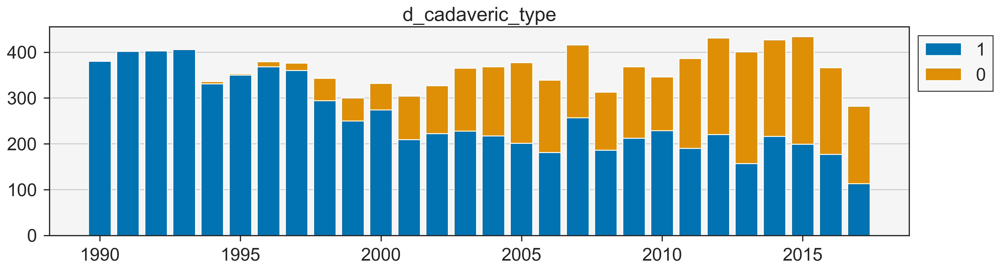

Column:	d_diabetes
Values:	
0.0    93.97
2.0     3.63
3.0     1.50
1.0     0.90
Name: d_diabetes, dtype: float64
Exported file:	 bar-year-d_diabetes-N


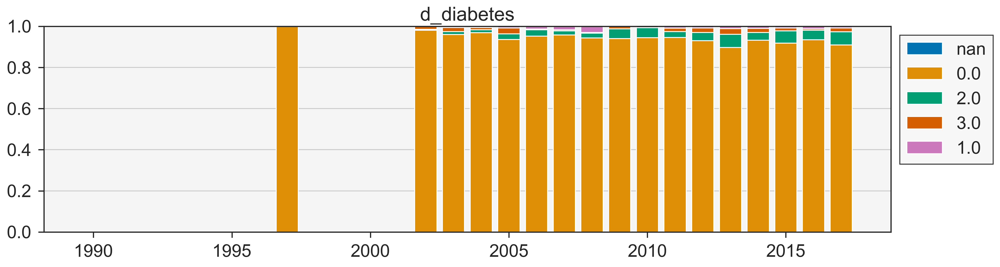

Exported file:	 bar-year-d_diabetes


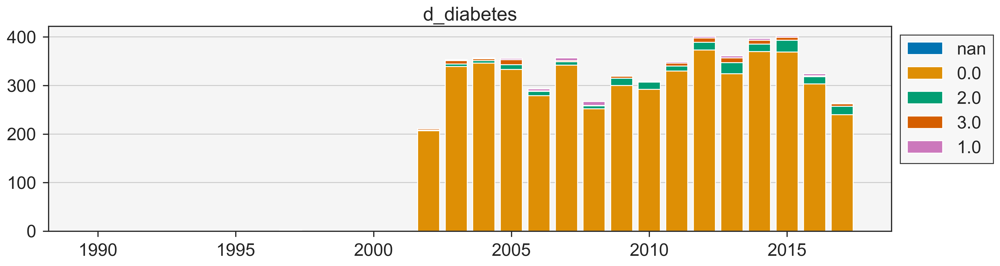

Column:	d_hypertension
Values:	
0.0    73.55
1.0    26.45
Name: d_hypertension, dtype: float64
Exported file:	 bar-year-d_hypertension-N


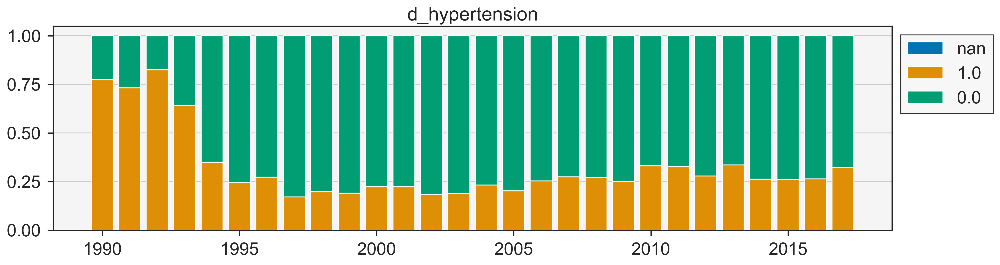

Exported file:	 bar-year-d_hypertension


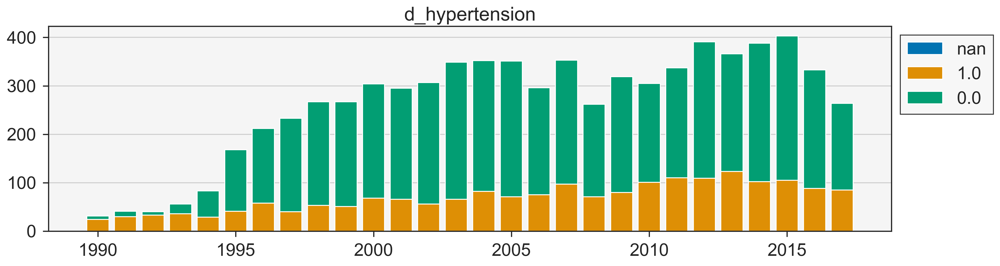

Column:	d_hypotensive_periods
Values:	
0.0    52.35
1.0    47.65
Name: d_hypotensive_periods, dtype: float64
Exported file:	 bar-year-d_hypotensive_periods-N


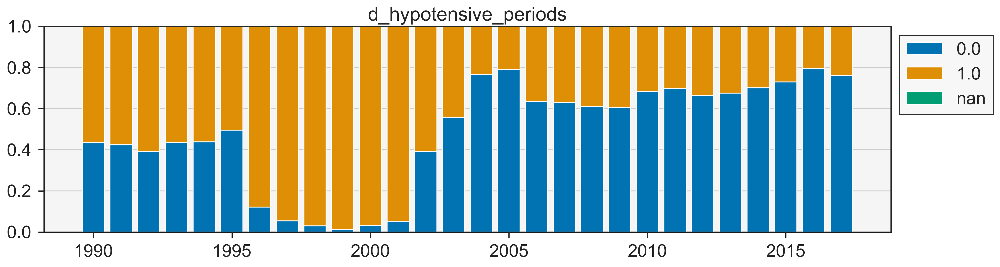

Exported file:	 bar-year-d_hypotensive_periods


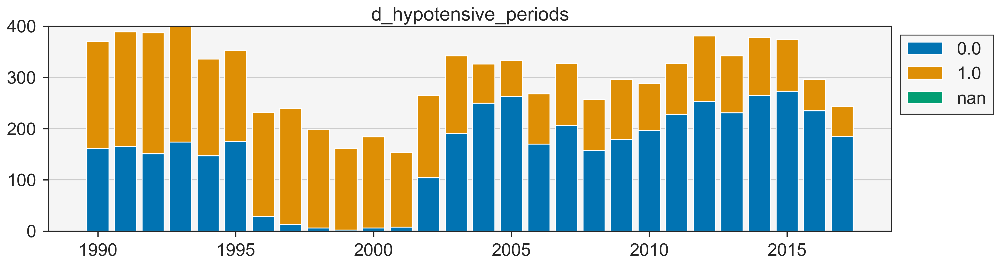

Column:	d_smoking
Values:	
0.0    50.03
1.0    49.97
Name: d_smoking, dtype: float64
Exported file:	 bar-year-d_smoking-N


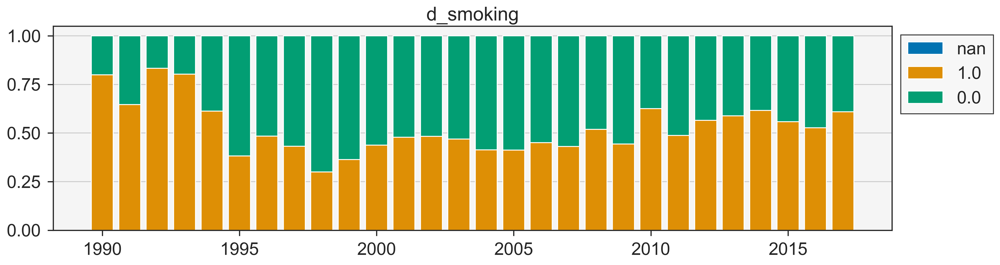

Exported file:	 bar-year-d_smoking


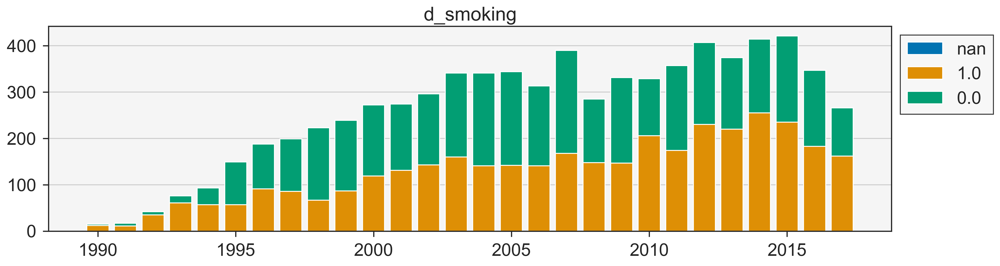

Column:	early_graftloss
Values:	
0    91.07
1     8.93
Name: early_graftloss, dtype: float64
Exported file:	 bar-year-early_graftloss-N


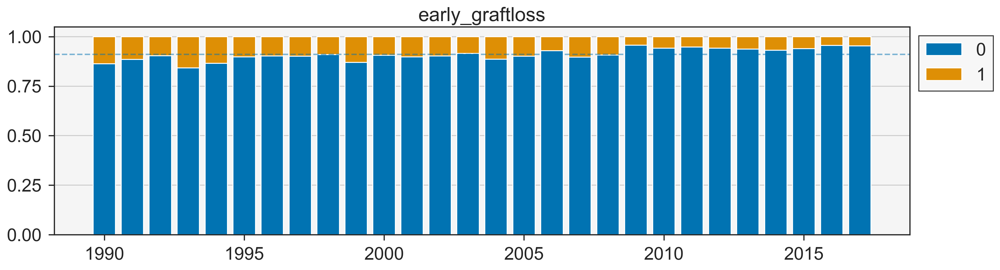

Exported file:	 bar-year-early_graftloss


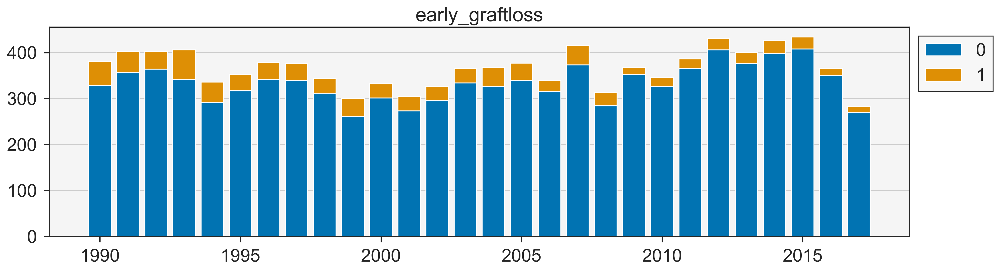

Column:	graftloss
Values:	
0    73.23
1    26.77
Name: graftloss, dtype: float64
Exported file:	 bar-year-graftloss-N


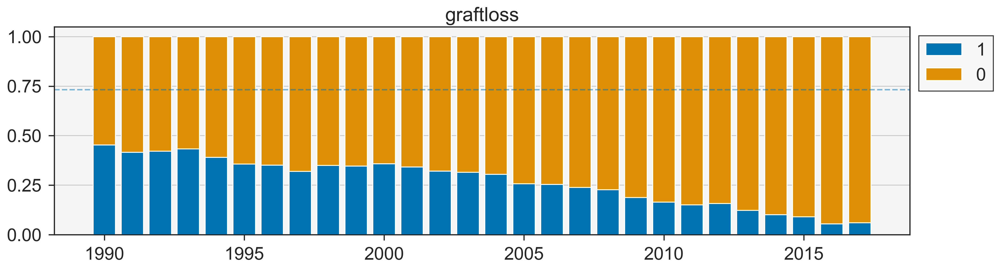

Exported file:	 bar-year-graftloss


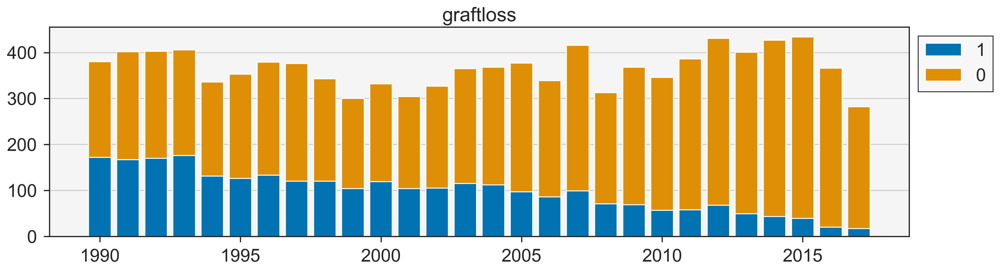

Column:	r_sex
Values:	
0    59.96
1    40.04
Name: r_sex, dtype: float64
Exported file:	 bar-year-r_sex-N


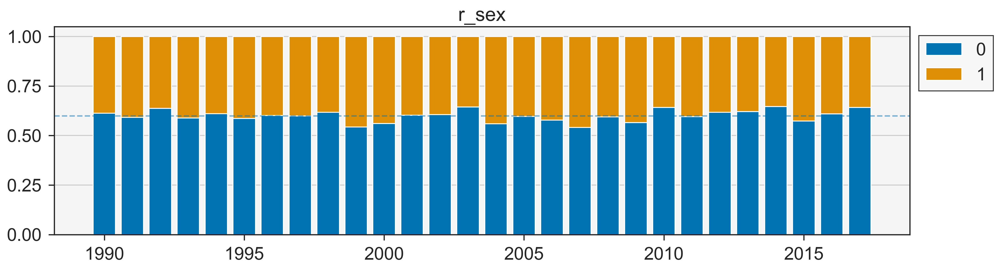

Exported file:	 bar-year-r_sex


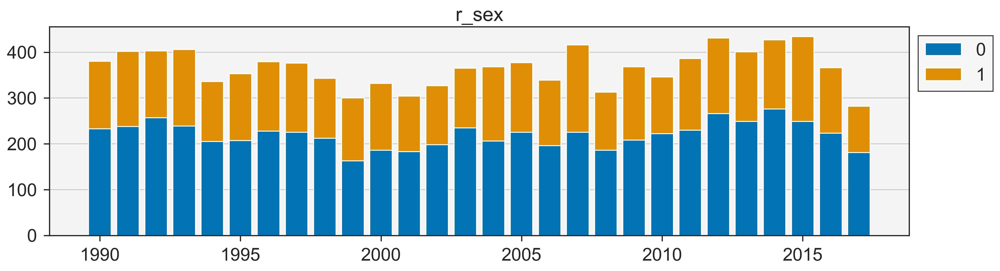

Column:	r_dead
Values:	
0    57.32
1    42.68
Name: r_dead, dtype: float64
Exported file:	 bar-year-r_dead-N


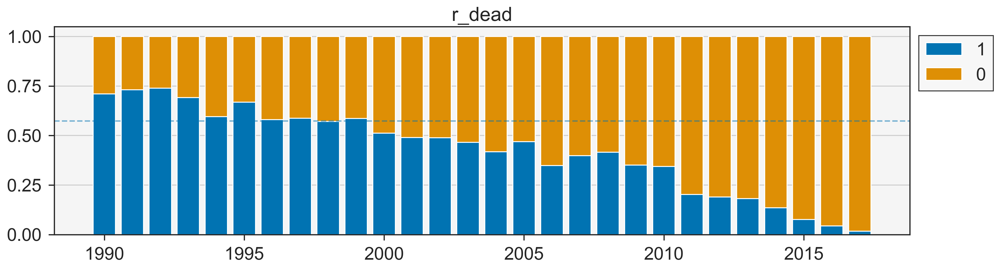

Exported file:	 bar-year-r_dead


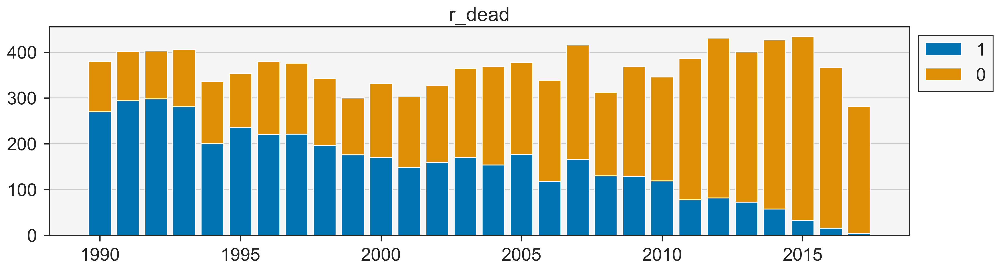

Column:	d_NHB_cat
Values:	
3.0    98.78
4.0     1.22
Name: d_NHB_cat, dtype: float64
Exported file:	 bar-year-d_NHB_cat-N


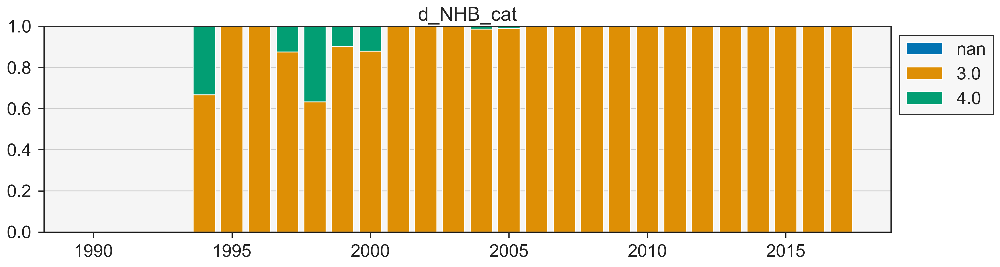

Exported file:	 bar-year-d_NHB_cat


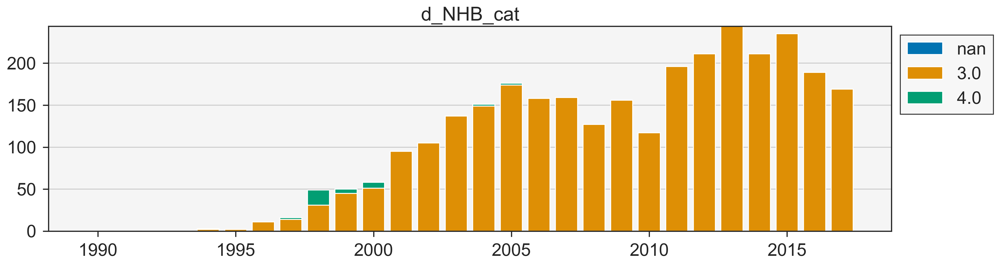

In [129]:
for ctype in binary_types:
    for column in column_types[ctype]:
        print(f"Column:\t{column}")
        plot_years_stacked(column)
        plot_years_stacked(column, normalize=False)

### Categoric

d_death_cause_cat
Values:	
2    50.22
1    29.01
4    15.49
3     5.28
Name: d_death_cause_cat, dtype: float64
Exported file:	 bar-year-d_death_cause_cat-N


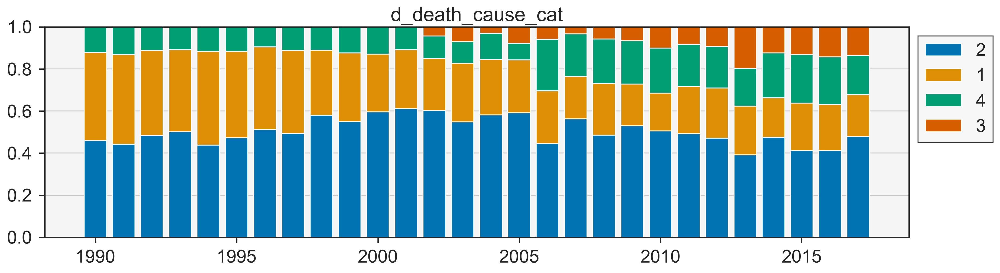

Exported file:	 bar-year-d_death_cause_cat


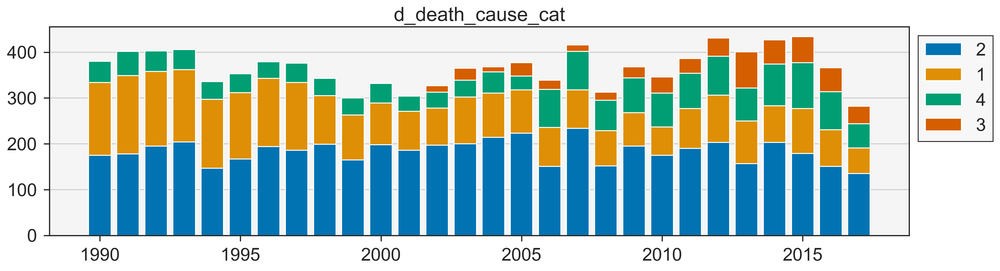

preservation_solution_type_cat
Values:	
6    60.82
1    28.47
3     4.66
7     3.64
9     1.01
8     0.79
4     0.35
0     0.21
2     0.04
5     0.01
Name: preservation_solution_type_cat, dtype: float64
Exported file:	 bar-year-preservation_solution_type_cat-N


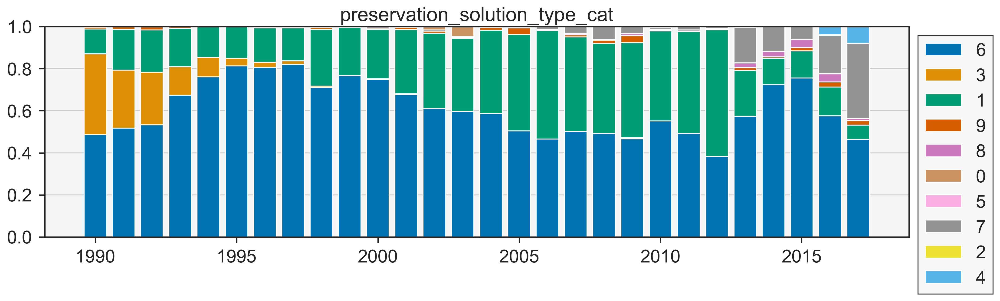

Exported file:	 bar-year-preservation_solution_type_cat


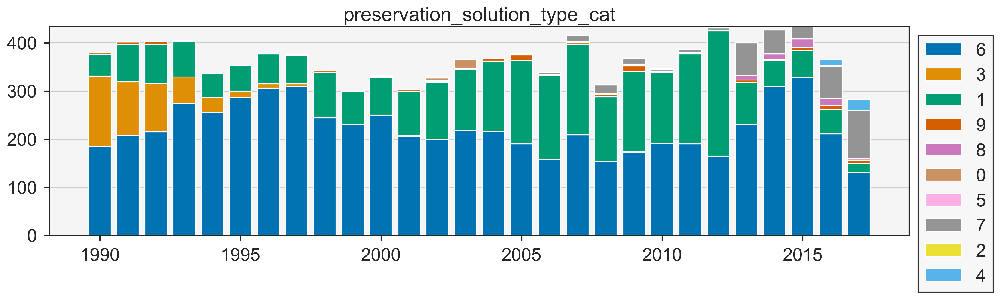

r_death_cause_cat
Values:	
1.0    34.32
0.0    34.19
3.0    19.56
2.0     3.72
5.0     3.70
4.0     3.43
6.0     1.07
Name: r_death_cause_cat, dtype: float64
Exported file:	 bar-year-r_death_cause_cat-N


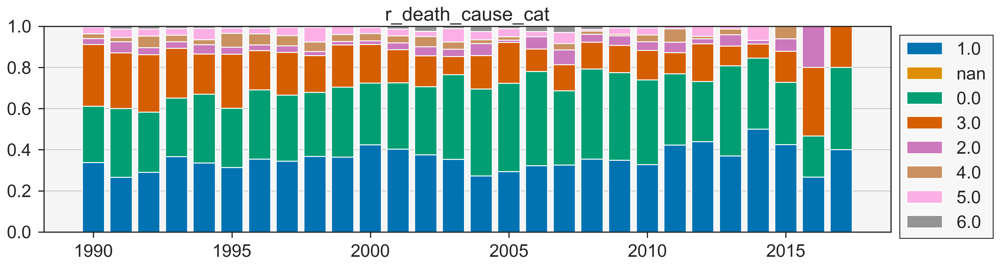

Exported file:	 bar-year-r_death_cause_cat


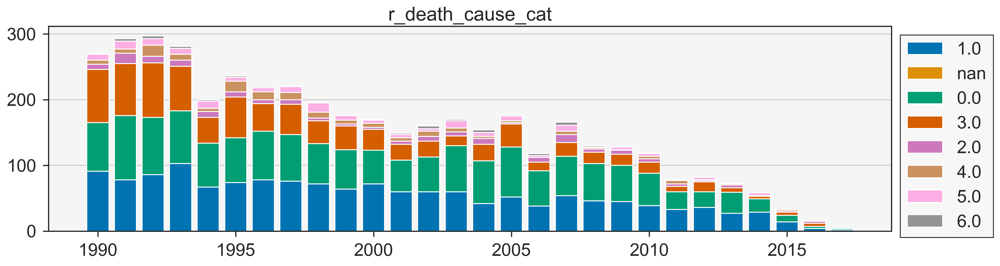

r_graft_fail_cause_cat
Values:	
0     45.73
1     27.50
3     15.79
15     2.02
10     1.92
6      1.75
7      1.23
11     0.74
5      0.63
4      0.49
13     0.48
8      0.46
12     0.36
2      0.29
16     0.26
9      0.22
14     0.13
Name: r_graft_fail_cause_cat, dtype: float64
Exported file:	 bar-year-r_graft_fail_cause_cat-N


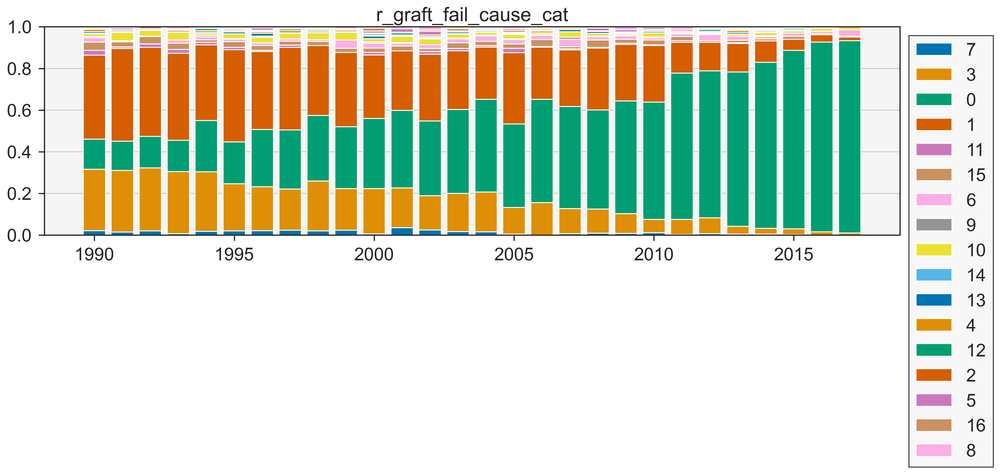

Exported file:	 bar-year-r_graft_fail_cause_cat


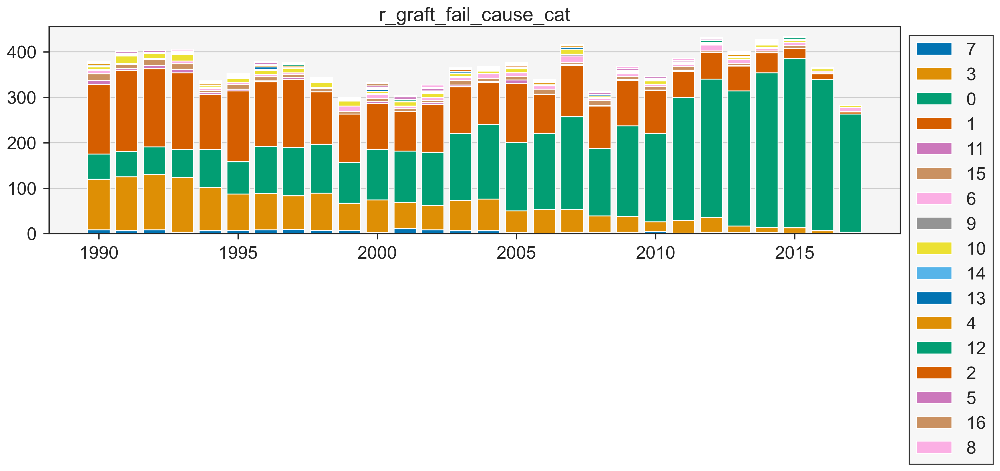

r_last_dialysis_technique_cat
Values:	
3     59.52
1     19.69
2     11.25
9      3.77
5      3.21
11     1.75
10     0.60
8      0.16
0      0.03
7      0.01
6      0.01
4      0.01
Name: r_last_dialysis_technique_cat, dtype: float64
Exported file:	 bar-year-r_last_dialysis_technique_cat-N


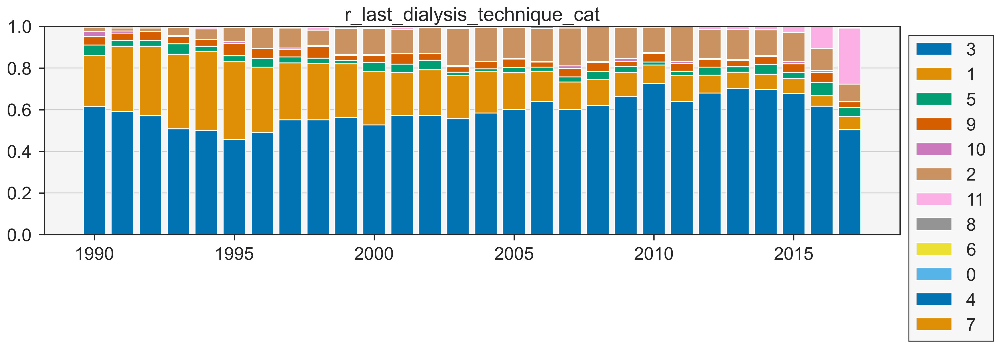

Exported file:	 bar-year-r_last_dialysis_technique_cat


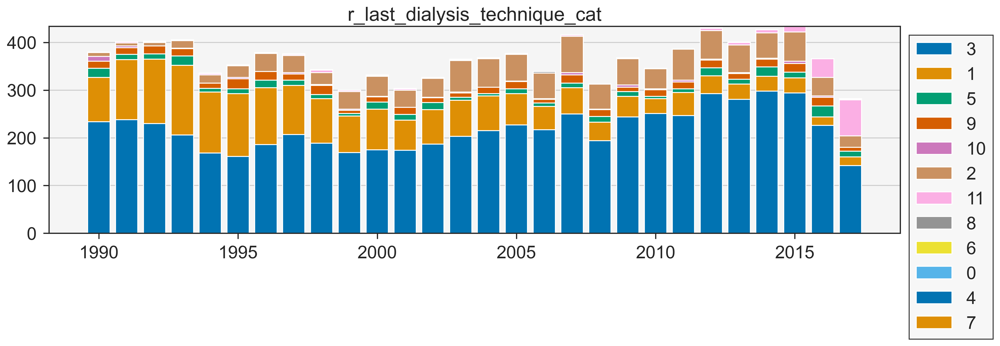

r_disease_recurrent
Values:	
1.0    47.24
2.0    26.55
0.0    26.21
Name: r_disease_recurrent, dtype: float64
Exported file:	 bar-year-r_disease_recurrent-N


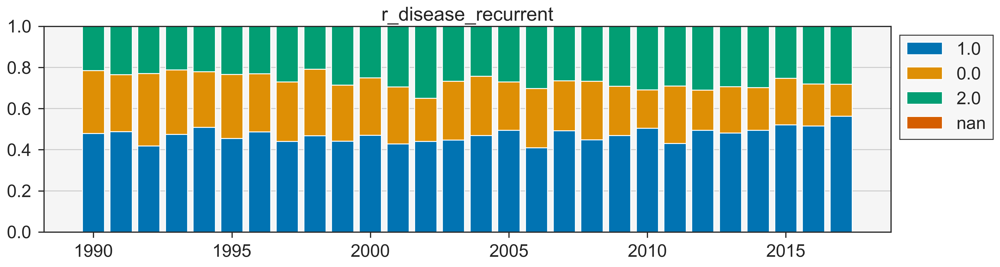

Exported file:	 bar-year-r_disease_recurrent


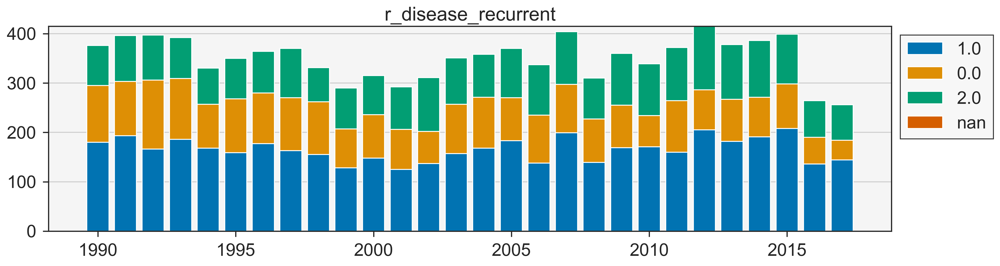

retransplant
Values:	
0    84.11
2     7.94
1     7.94
Name: retransplant, dtype: float64
Exported file:	 bar-year-retransplant-N


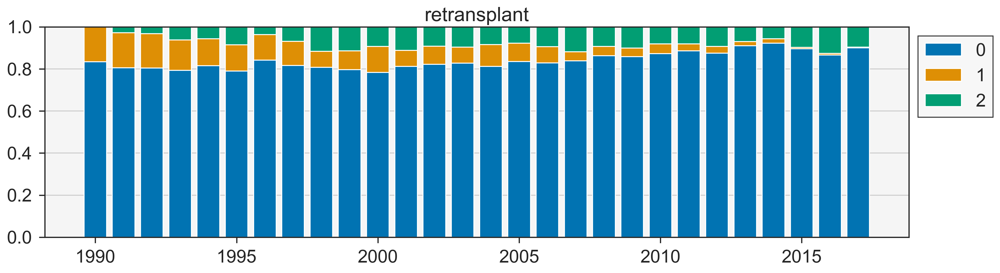

Exported file:	 bar-year-retransplant


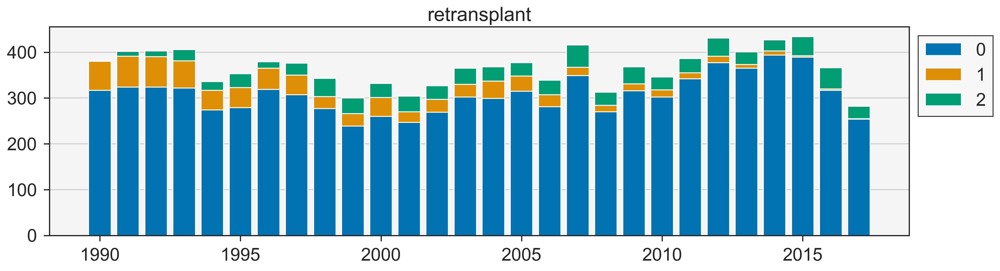

mismatch_A
Values:	
1.0    50.38
0.0    36.49
2.0    13.13
Name: mismatch_A, dtype: float64
Exported file:	 bar-year-mismatch_A-N


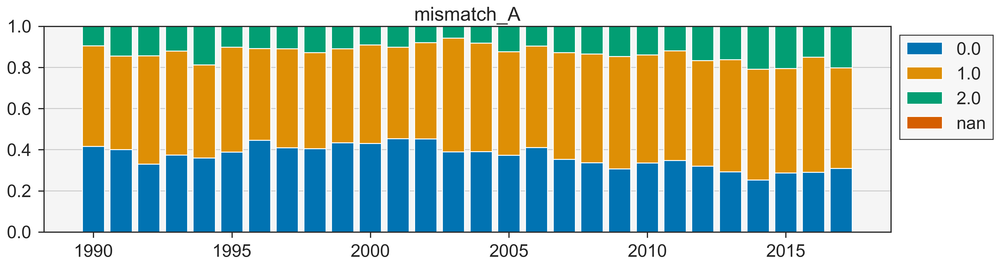

Exported file:	 bar-year-mismatch_A


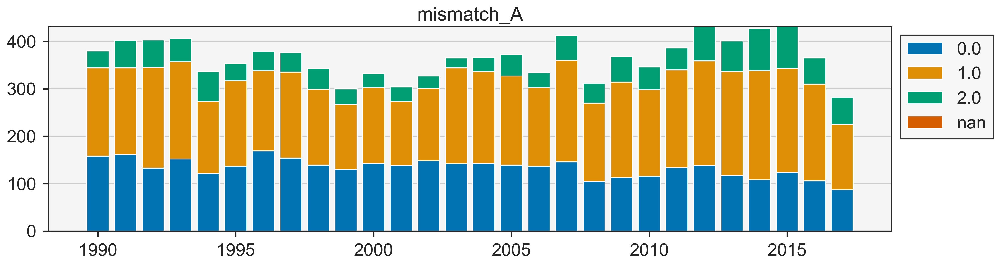

mismatch_B
Values:	
1.0    54.50
0.0    26.27
2.0    19.23
Name: mismatch_B, dtype: float64
Exported file:	 bar-year-mismatch_B-N


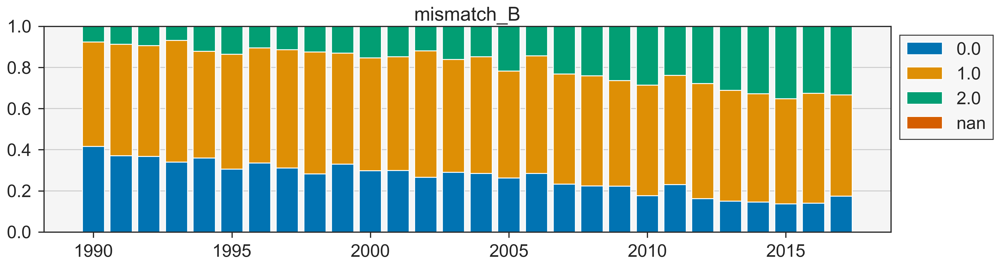

Exported file:	 bar-year-mismatch_B


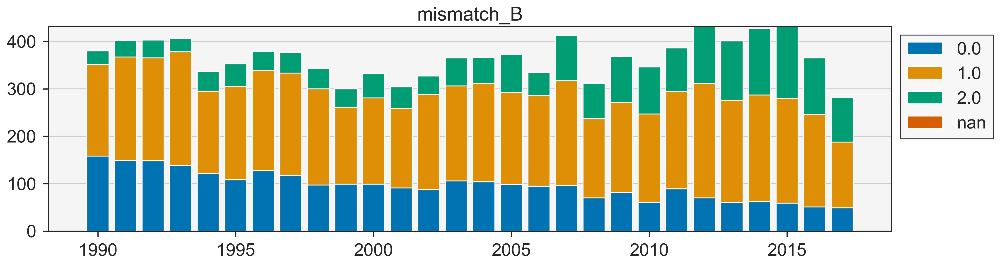

mismatch_DR
Values:	
1.0    47.73
0.0    46.92
2.0     5.36
Name: mismatch_DR, dtype: float64
Exported file:	 bar-year-mismatch_DR-N


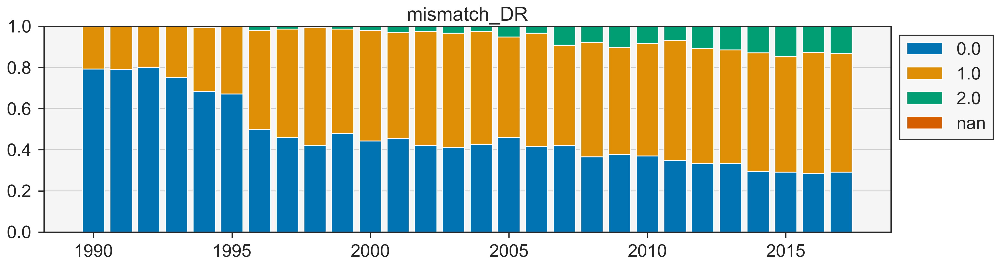

Exported file:	 bar-year-mismatch_DR


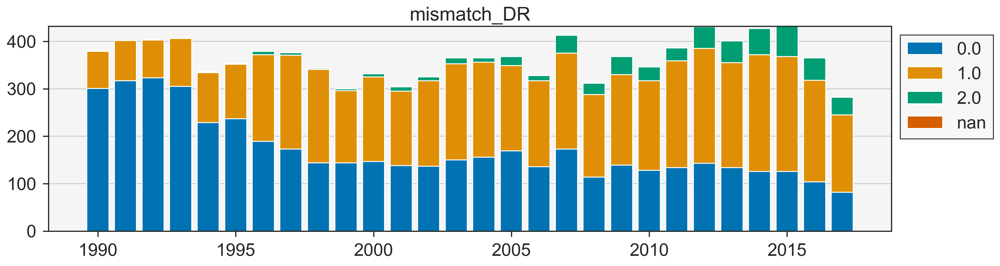

In [130]:
for ctype in categoric_types:
    for column in column_types[ctype]:
        print(column)
        plot_years_stacked(column)
        plot_years_stacked(column, normalize=False)

## Date Difference plots

In [131]:
def plot_date_diff_bar(column):   
    # Calculate value_counts and set index
    values = df[column].value_counts()
    x = values.index.tolist()
    
    # Plot figure
    plt.figure(figsize=(16,4))
    plt.bar(x, values, **{'color': 'blue'})
    plt.title(column)
    plt.ylabel('Amount')
    plt.xlabel('Date difference')
    if export:
        filename = 'bar-date_diff-{}'.format(column)
        plt.savefig("plots/{}.png".format(filename))
        print("Exported file:\t", filename)
    plt.show()

Exported file:	 bar-date_diff-d_death_date_diff


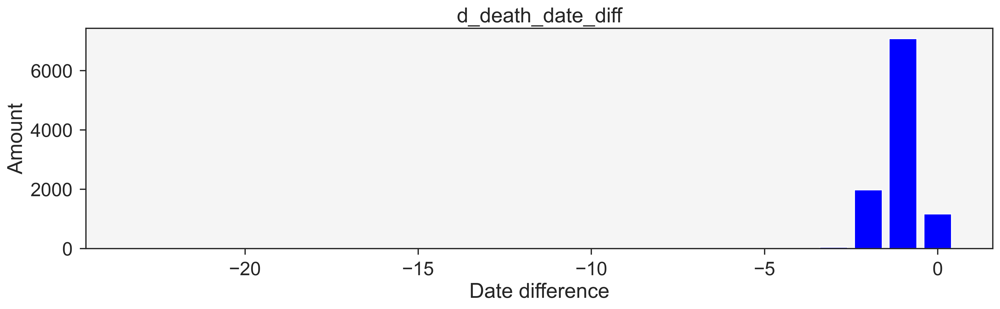

Exported file:	 bar-date_diff-d_nephrectomy_date_diff


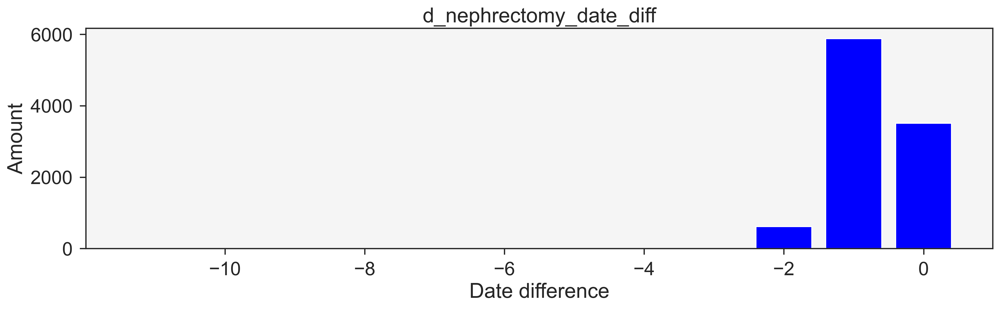

Exported file:	 bar-date_diff-r_death_date_diff


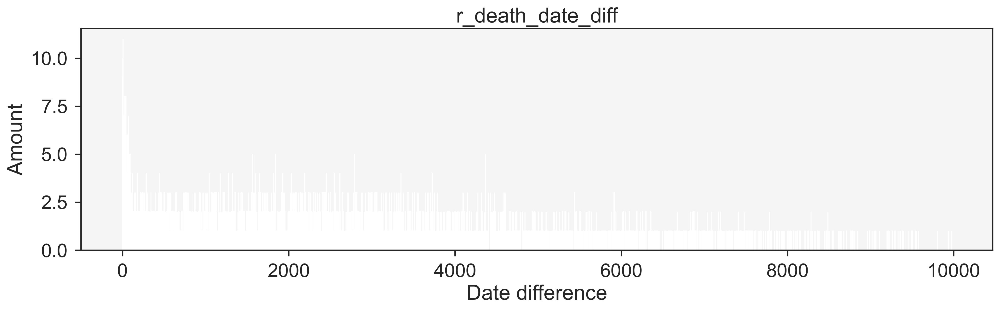

Exported file:	 bar-date_diff-r_first_dialysis_date_diff


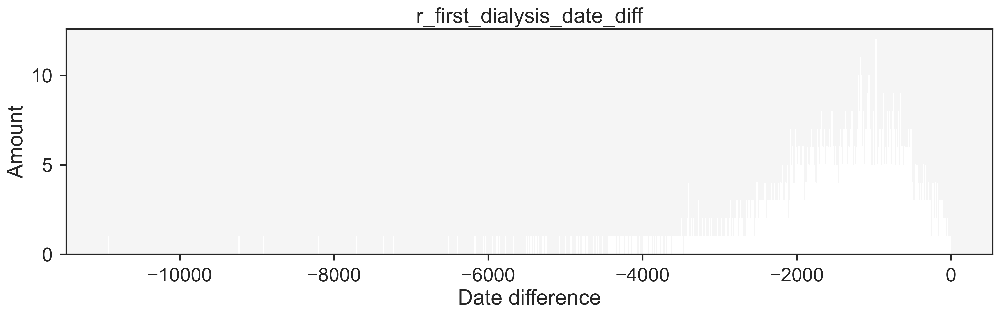

Exported file:	 bar-date_diff-r_graft_fail_date_diff


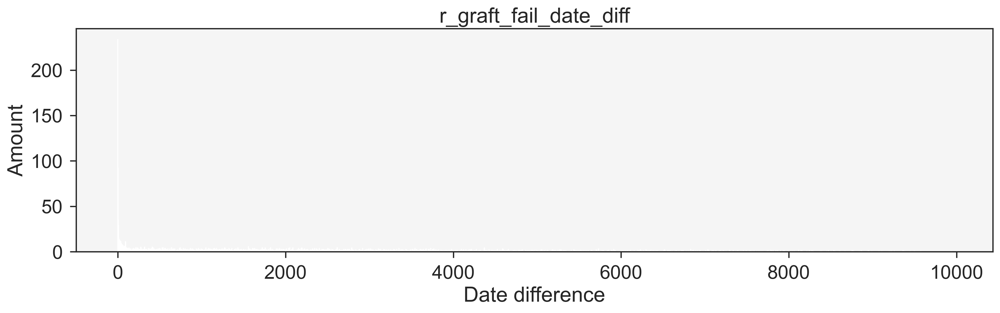

Exported file:	 bar-date_diff-r_seen_date_diff


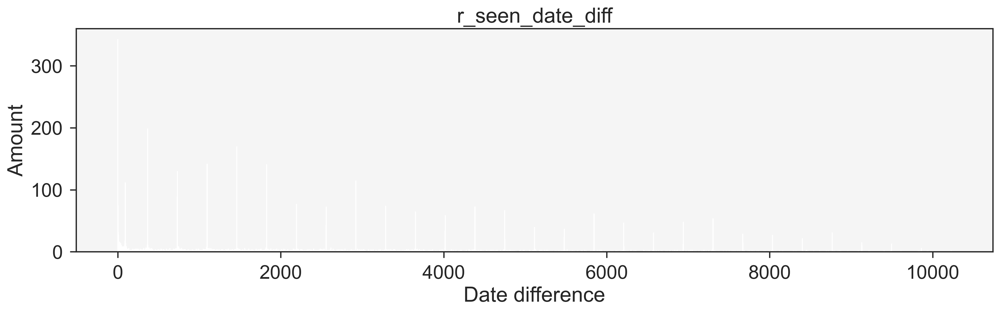

Exported file:	 bar-date_diff-retransplant_days


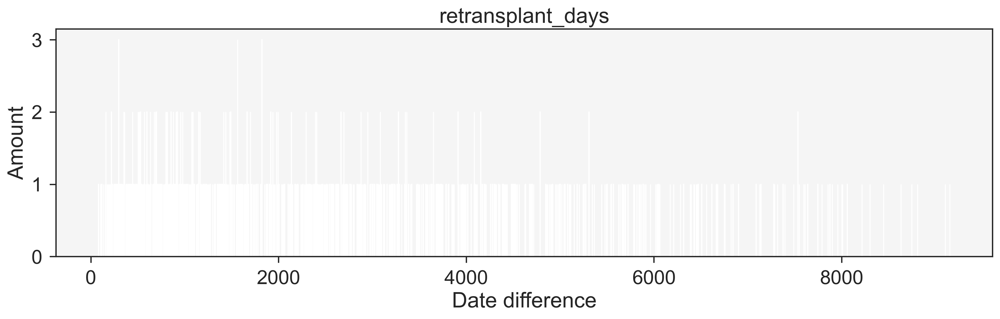

In [132]:
for ctype in date_diff_types:
    for column in column_types[ctype]:
        plot_date_diff_bar(column)

## Univariate Analysis

In [133]:
def perc(amt, total):
    return round(100*amt/total,1)

def compare_percentage(data, column, key=0):
    values = data[column].value_counts(normalize=True)
    print(values)
    
def clean_list(lst):
    return [x for x in lst if str(x) != 'nan']

In [134]:
# p-value tests
def mannwhitney(a, b):
    stat, p = stats.mannwhitneyu(a, b, use_continuity=True, alternative=None)
    return float(p)

def fisher_exact(a, b):
    stat, p = stats.fisher_exact([[0,0],[0,0]], alternative='two-sided')
    return float(p)

def chisquare(a, b):
    a = a.value_counts()
    b = b.value_counts()
    for key in a.index:
        if key not in b.index:
            b = b.append(pd.Series([0], index=[key]))
    for key in b.index:
        if key not in a.index:
            a = a.append(pd.Series([0], index=[key]))
    obs = np.array([a, b]).T
    stat, p = stats.chisquare(obs, axis=None)
    return float(p)

def ttest(a, b):
    stat, p = stats.ttest_ind(a, b, axis=None, equal_var=True, nan_policy='omit')
    return float(p)

def spearmanr(a, b):
    stat, p = stats.spearmanr(a, b, axis=None)
    return stat, p

In [135]:
mean_columns = []
for ctype in numerical_types:
    mean_columns += column_types[ctype]
binary_columns = column_types['binary'] + column_types['pseudo_binary']
categoric_columns = column_types['categoric'] + column_types['mismatch']

In [136]:
def compare(ix_yes, ix_no=None, name_yes='Has', name_no='Not', latex=False, subset=ix_all):
    
    if ix_no is None:
        ix_no = ~ix_yes
    
    yes = df[subset & ix_yes]
    no = df[subset & ix_no]
    
    length_total = len(df)
    length_yes = len(yes)
    length_no = len(no)
    
    if latex:
        print("\\begin{table}[]")
        print("\\centering")
        print("\\tiny")
        print("\\begin{tabular}{|l|l|l|l|}")
        print("\\hline")
    
    # Group
    name = 'COLUMN/GROUP\t\t\t'
    if not latex: print(f"{name}{name_yes}\t\t{name_no}\t\t\tp-value")
    else: print(f"COLUMN/GROUP & {name_yes} & {name_no} & p-value \\\\ \\hline")
    
    # Amount
    name = 'Amount\t\t\t\t'
    n_yes = length_yes
    n_no = length_no
    n_yes_perc = perc(length_yes, length_total)
    n_no_perc = perc(length_no, length_total)
    if not latex: print(f"{name}{n_yes} ({n_yes_perc}%)\t{n_no} ({n_no_perc}%)")
    else: print(f"AMOUNT & {n_yes} ({n_yes_perc}\\%) & {n_no} ({n_no_perc}\\%) & \\\\")
    
    columns = mean_columns + binary_columns + categoric_columns + date_diff_columns
    
    for column in columns:
        name = column
        if not latex:
            if len(name) <= 6:
                name += '\t'
            if len(name) <= 15:
                name += '\t'
            if len(name) <= 23:
                name += '\t'
        else:
            name = name.replace('_', '\_')
            
        dtype = df[column].dtype
        uniq = clean_list(sorted(df[column].unique())) # clean_list() as well?
            
        if uniq == [0, 1]:
            n_yes = int(yes[column].sum()) # length_yes - 
            n_no = int(no[column].sum()) # length_no - 
            n_yes_perc = perc(n_yes, length_yes)
            n_no_perc = perc(n_no, length_no)
            if column != 'early_graftloss' and column != 'graftloss':
                p = round(chisquare(yes[column], no[column]), 3)
            else: p = 'X'
            if p == 0: 
                if not latex: p = "<0.001"
                else: p = "$<$0.001"
            if not latex: print(f"{name}\t{n_yes} ({n_yes_perc}%)\t{n_no} ({n_no_perc}%)\t\t{p}\N{SUPERSCRIPT TWO}")
            else: print(f"\\hline {name} & {n_yes} ({n_yes_perc}\\%) & {n_no} ({n_no_perc}\\%) & {p}\\textss{{2}} \\\\")
            
        elif (((dtype == 'int64' or dtype == 'float64') and len(uniq) <= 10) and ("_date_diff" not in column)) or ("_cat" in column):
            p = round(chisquare(yes[column], no[column]), 3)
            if p == 0: 
                if not latex: p = "<0.001"
                else: p = "$<$0.001"
            if not latex: print(f"{name}\t\t\t\t\t\t{p}\N{SUPERSCRIPT TWO}")
            else: print(f"\\hline {name} & & & {p}\\textss{{2}} \\\\")
            u_yes_unknown = length_yes
            u_no_unknown = length_no
            for u in uniq:
                u_yes = len(yes[yes[column] == u])
                u_yes_perc = perc(u_yes, length_yes)
                u_no = len(no[no[column] == u])
                u_no_perc = perc(u_no, length_no)
                u_yes_unknown -= u_yes
                u_no_unknown -= u_no
                if not latex: print(f"\t\t\t{int(u)}\t{u_yes} ({u_yes_perc}%)\t{u_no} ({u_no_perc}%)")
                else: print("\\multicolumn{{1}}{{|r|}}{{{}}} & {} ({}\\%) & {} ({}\\%) & \\\\".format(int(u), u_yes, u_yes_perc, u_no, u_no_perc))
                
            if u_yes_unknown > 0 or u_no_unknown > 0:
                u_yes_unknown_perc = perc(u_yes_unknown, length_yes)
                u_no_unknown_perc = perc(u_no_unknown, length_no)
                if not latex: print(f"\t\t\tu\t{u_yes_unknown} ({u_yes_unknown_perc}%)\t{u_no_unknown} ({u_no_unknown_perc}%)")    
                else: print("\\multicolumn{{1}}{{|r|}}{{}} & {} ({}\\%) & {} ({}\\%) & \\\\".format(u_yes_unknown, u_yes_unknown_perc, u_no_unknown, u_no_unknown_perc))
            
        elif ((dtype == 'int64' or dtype == 'float64') and len(uniq) > 10) or ("_date_diff" in column):
            n_yes = round(yes[column].mean(),1)
            n_no = round(no[column].mean(),1)
            n_yes_std = round(yes[column].std(),1)
            n_no_std = round(no[column].std(),1)
            p = round(ttest(yes[column], no[column]), 3)
            if p == 0:
                if not latex: p = "<0.001"
                else: p = "$<$0.001"
            if not latex: print(f"{name}\t{n_yes} ± {n_yes_std}\t{n_no} ± {n_no_std}\t\t{p}\N{SUPERSCRIPT ONE}")
            else: print("\\hline {} & {} $\pm$ {} & {} $\pm$ {} & {}\\textss{{1}} \\\\".format(name, n_yes, n_yes_std, n_no, n_no_std, p))
#                         
        else:
            if not latex: print(column)
            else:
                print("\\hline {} & & & \\\\".format(column))
            
    if latex:
        print("\hline")
        print("\end{tabular}")
        print("\end{table}")
    else:
        print('-'*80)
        print('P-tests:')
        print(f"\N{SUPERSCRIPT ONE}ttest - continuous values")
        print(f"\N{SUPERSCRIPT TWO}chi-square - categorical values")

In [137]:
def calc_oddsratio(minp = 0.05):
    for column in list(df.columns):
        g = grouping(df, [egl, column])
        if len(g) == 4:
            or_, p_ = stats.fisher_exact([[g[0].iloc[0], g[1].iloc[0]], [g[0].iloc[1], g[1].iloc[1]]])
            if p_ < minp:
                print(f"{column}  \t{round(or_,3)}\t{round(p_,3)}")
                se = 1.96 * np.sqrt( (1/g[0].iloc[0]) + (1/g[1].iloc[0]) + (1/g[0].iloc[1]) + (1/ g[1].iloc[1]))

calc_oddsratio()

d_hypertension  	1.306	0.004
r_dead  	0.835	0.012
retransplant_after  	12.14	0.0
egl_after  	13.334	0.0
egl_before  	2.213	0.0
egl_first  	1.777	0.001
egl_before_d30  	1.952	0.0
mort  	7.593	0.0
mort_d30  	7.593	0.0
mort_y1  	5.157	0.0
mort_y5  	3.503	0.0
mort_y10  	2.566	0.0


In [138]:
%%capture --no-stdout
compare(ix_egl, name_yes='EGL', name_no='No EGL', latex=False)

COLUMN/GROUP			EGL		No EGL			p-value
Amount				916 (8.9%)	9345 (91.1%)
r_age				49.7 ± 14.7	50.5 ± 14.4		0.146¹
d_age				48.4 ± 16.1	46.2 ± 16.3		<0.001¹
r_BMI				25.8 ± 4.7	25.1 ± 4.4		<0.001¹
d_BMI				25.3 ± 5.0	24.8 ± 4.2		0.002¹
d_MDRD				96.3 ± 45.1	102.1 ± 43.7		<0.001¹
r_MDRD_M3			13.1 ± 7.6	46.4 ± 19.2		<0.001¹
r_MDRD_Y1			19.2 ± 18.4	48.6 ± 19.0		0.002¹
r_MDRD_Y5			nan ± nan	48.7 ± 20.3		nan¹
r_height			171.0 ± 11.2	171.2 ± 10.4		0.668¹
d_height			172.0 ± 13.4	173.5 ± 11.6		0.001¹
r_weight			75.4 ± 16.3	73.8 ± 15.2		0.01¹
d_weight			75.3 ± 18.2	75.2 ± 16.1		0.917¹
ischaemic_period_cold		1375.2 ± 496.8	1230.8 ± 477.9		<0.001¹
ischaemic_period_warm_1		6.7 ± 11.1	5.7 ± 9.3		0.006¹
ischaemic_period_warm_2		37.8 ± 15.8	34.5 ± 12.5		<0.001¹
d_sex				425 (46.4%)	4295 (46.0%)		<0.001²
d_cardiac_arrest		216 (23.6%)	2272 (24.3%)		<0.001²
d_cadaveric_type		647 (70.6%)	6585 (70.5%)		<0.001²
d_diabetes								<0.001²
			0	350 (38.2%)	4651 (49.8%)
			1	1 (0.1%)	47 (0.5%)
			2	25 (2.7%)	168 

In [139]:
%%capture --no-stdout
compare(ix_egl, name_yes='EGL', name_no='No EGL', latex=False, subset=ix_tx01)

COLUMN/GROUP			EGL		No EGL			p-value
Amount				809 (7.9%)	8637 (84.2%)
r_age				50.2 ± 14.7	50.7 ± 14.4		0.302¹
d_age				49.0 ± 16.2	46.2 ± 16.4		<0.001¹
r_BMI				26.0 ± 4.8	25.2 ± 4.4		<0.001¹
d_BMI				25.3 ± 5.0	24.8 ± 4.2		0.001¹
d_MDRD				96.6 ± 46.2	102.0 ± 43.6		0.001¹
r_MDRD_M3			13.4 ± 7.8	46.4 ± 19.2		<0.001¹
r_MDRD_Y1			10.0 ± 1.4	48.6 ± 18.9		<0.001¹
r_MDRD_Y5			nan ± nan	48.9 ± 20.2		nan¹
r_height			171.1 ± 11.4	171.2 ± 10.4		0.815¹
d_height			171.8 ± 13.2	173.4 ± 11.6		<0.001¹
r_weight			76.0 ± 16.7	73.9 ± 15.2		0.003¹
d_weight			75.1 ± 18.3	75.1 ± 16.1		0.998¹
ischaemic_period_cold		1370.7 ± 497.7	1227.9 ± 483.2		<0.001¹
ischaemic_period_warm_1		6.8 ± 11.2	5.7 ± 9.3		0.004¹
ischaemic_period_warm_2		37.9 ± 15.6	34.5 ± 12.5		<0.001¹
d_sex				377 (46.6%)	3961 (45.9%)		<0.001²
d_cardiac_arrest		194 (24.0%)	2118 (24.5%)		<0.001²
d_cadaveric_type		569 (70.3%)	6070 (70.3%)		<0.001²
d_diabetes								<0.001²
			0	305 (37.7%)	4289 (49.7%)
			1	1 (0.1%)	43 (0.5%)
			2	23 (2.8%)	161

In [140]:
compare(ix_dbd, name_yes='DBD', name_no='DCD', subset=ix_year_after[2004]) # 2008 is better, but keyerror 0.0 at d_NHB_cat

COLUMN/GROUP			DBD		DCD			p-value
Amount				2538 (24.7%)	2349 (22.9%)
r_age				54.2 ± 14.2	55.1 ± 13.0		0.023¹
d_age				51.6 ± 15.0	50.8 ± 14.8		0.081¹
r_BMI				25.7 ± 4.5	26.2 ± 4.5		<0.001¹
d_BMI				25.4 ± 4.5	25.4 ± 4.7		0.925¹
d_MDRD				100.9 ± 40.4	113.0 ± 43.1		<0.001¹
r_MDRD_M3			48.4 ± 19.8	44.2 ± 18.1		<0.001¹
r_MDRD_Y1			50.0 ± 19.6	47.6 ± 18.7		<0.001¹
r_MDRD_Y5			50.0 ± 20.7	47.0 ± 20.4		0.004¹
r_height			170.7 ± 10.2	171.7 ± 10.7		0.002¹
d_height			172.8 ± 10.4	175.2 ± 10.5		<0.001¹
r_weight			75.0 ± 15.5	77.6 ± 15.8		<0.001¹
d_weight			76.1 ± 16.0	78.3 ± 16.9		<0.001¹
ischaemic_period_cold		1002.5 ± 384.2	930.1 ± 300.1		<0.001¹
ischaemic_period_warm_1		0.2 ± 1.3	17.2 ± 6.1		<0.001¹
ischaemic_period_warm_2		35.0 ± 13.3	34.2 ± 13.0		0.06¹
d_sex				1345 (53.0%)	948 (40.4%)		<0.001²
d_cardiac_arrest		572 (22.5%)	913 (38.9%)		<0.001²
d_cadaveric_type		2538 (100.0%)	0 (0.0%)		<0.001²
d_diabetes								<0.001²
			0	1954 (77.0%)	2153 (91.7%)
			1	18 (0.7%)	26 (1.1%)
			2	96 (3.8%

In [141]:
compare(ix_egl_d30, name_yes='EGL-30', name_no='Non EGL') # 2008 is better, but keyerror 0.0 at d_NHB_cat

COLUMN/GROUP			EGL-30		Non EGL			p-value
Amount				685 (6.7%)	9576 (93.3%)
r_age				49.4 ± 14.8	50.5 ± 14.4		0.058¹
d_age				48.3 ± 16.1	46.3 ± 16.3		0.001¹
r_BMI				25.9 ± 4.8	25.1 ± 4.4		<0.001¹
d_BMI				25.2 ± 4.9	24.8 ± 4.2		0.014¹
d_MDRD				97.3 ± 45.2	101.9 ± 43.7		0.008¹
r_MDRD_M3			11.7 ± 6.6	46.3 ± 19.2		<0.001¹
r_MDRD_Y1			29.1 ± 24.9	48.6 ± 19.0		0.146¹
r_MDRD_Y5			nan ± nan	48.7 ± 20.3		nan¹
r_height			171.2 ± 11.4	171.2 ± 10.4		0.882¹
d_height			172.0 ± 13.6	173.4 ± 11.6		0.003¹
r_weight			76.0 ± 16.6	73.8 ± 15.2		0.002¹
d_weight			75.2 ± 18.2	75.2 ± 16.2		0.978¹
ischaemic_period_cold		1361.1 ± 501.1	1235.3 ± 478.8		<0.001¹
ischaemic_period_warm_1		6.9 ± 11.5	5.7 ± 9.3		0.004¹
ischaemic_period_warm_2		37.9 ± 16.4	34.5 ± 12.5		<0.001¹
d_sex				314 (45.8%)	4406 (46.0%)		<0.001²
d_cardiac_arrest		172 (25.1%)	2316 (24.2%)		<0.001²
d_cadaveric_type		477 (69.6%)	6755 (70.5%)		<0.001²
d_diabetes								<0.001²
			0	262 (38.2%)	4739 (49.5%)
			1	1 (0.1%)	47 (0.5%)
			2	22 (3.2%)	1

/Users/joost/Documents/.virtualenvironments/rp/lib/python3.7/site-packages/ipykernel_launcher.py:25: UserWarning: Warning: converting a masked element to nan.


			0	327 (47.7%)	8304 (86.7%)
			1	273 (39.9%)	542 (5.7%)
			2	85 (12.4%)	730 (7.6%)
mismatch_A								<0.001²
			0	226 (33.0%)	3512 (36.7%)
			1	362 (52.8%)	4798 (50.1%)
			2	97 (14.2%)	1248 (13.0%)
			u	0 (0.0%)	18 (0.2%)
mismatch_B								<0.001²
			0	144 (21.0%)	2547 (26.6%)
			1	398 (58.1%)	5184 (54.1%)
			2	143 (20.9%)	1827 (19.1%)
			u	0 (0.0%)	18 (0.2%)
mismatch_DR								<0.001²
			0	312 (45.5%)	4487 (46.9%)
			1	343 (50.1%)	4539 (47.4%)
			2	29 (4.2%)	519 (5.4%)
			u	1 (0.1%)	31 (0.3%)
d_death_date_diff		-1.1 ± 0.6	-1.1 ± 0.6		0.022¹
d_nephrectomy_date_diff		-0.9 ± 0.7	-0.7 ± 0.6		<0.001¹
r_death_date_diff		2095.0 ± 2208.7	2854.2 ± 2142.1		<0.001¹
r_first_dialysis_date_diff	-1469.8 ± 867.6	-1427.5 ± 851.1		0.362¹
r_graft_fail_date_diff		6.3 ± 8.3	2391.3 ± 2024.7		<0.001¹
r_seen_date_diff		40.4 ± 231.8	2642.0 ± 2292.1		<0.001¹
retransplant_days		1080.1 ± 870.2	3257.4 ± 1968.3		<0.001¹
--------------------------------------------------------------------------------
P-tests:
¹tt

In [142]:
print_columns(df)

d_BMI
d_BMI_cat
d_MDRD
d_NHB_cat
d_admission_date_diff
d_age
d_age_cat
d_cadaveric_type
d_cardiac_arrest
d_creatinine
d_death_cause_cat
d_death_date_diff
d_diabetes
d_height
d_hypertension
d_hypotensive_periods
d_hypotensive_periods_duration
d_id
d_nephrectomy_date_diff
d_sex
d_smoking
d_weight
difference_BMI
difference_age
difference_sex
duration
duration_rt
early_graftloss
early_graftloss_d30
egl_after
egl_before
egl_before_d30
egl_first
fail_death_diff
graftloss
id
ischaemic_period_cold
ischaemic_period_warm_1
ischaemic_period_warm_2
km_fail_death_diff
km_graft
km_retransplant_wait
mismatch_A
mismatch_B
mismatch_DR
mort
mort_d30
mort_y1
mort_y10
mort_y5
preservation_solution_type_cat
preservation_solution_volume
r_BMI
r_BMI_cat
r_MDRD_M3
r_MDRD_Y1
r_MDRD_Y5
r_PRA
r_PRA_cat
r_age
r_age_cat
r_blood_group
r_combined_transplants
r_creatinine_M3
r_creatinine_Y1
r_creatinine_Y5
r_dead
r_death_cause_cat
r_death_date_diff
r_delayed_graft_function
r_disease_recurrent
r_first_dialysis_date_di

# Sandbox
To play around with code.